In [84]:
from h5glance import H5Glance

import os
import sys
import h5py
import math
import numpy  as np
import pandas as pd

from scipy    import stats
from datetime import datetime, timezone

from lgdo import LH5Store #If this fails, try pip install legend-pydataobj
import lgdo.lh5_store as lh5

import matplotlib.pyplot as plt

from legendmeta import LegendMetadata
#from pygama.flow import DataLoader

from scipy import stats as st

In [211]:
repository_path = os.path.abspath('/Users/romoluque_c/Repositories/BACON_romo/')
sys.path.append(repository_path)

import peak_functions as pf
import fit_functions  as fitf

In [13]:
#!pip install pygama

  Using cached pygama-1.3.2-py3-none-any.whl (311 kB)
  Using cached iminuit-2.24.0-cp310-cp310-macosx_10_9_universal2.whl (650 kB)
  Using cached pyFFTW-0.13.1.tar.gz (114 kB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached xmltodict-0.13.0-py2.py3-none-any.whl (10.0 kB)
  Using cached pyfcutils-0.2.4-cp310-cp310-macosx_10_9_universal2.whl (181 kB)
  error: subprocess-exited-with-error
  
  × Building wheel for pyfftw (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> [40 lines of output]
      running bdist_wheel
      running build
      running build_py
      creating build
      creating build/lib.macosx-11.1-arm64-3.10
      creating build/lib.macosx-11.1-arm64-3.10/pyfftw
      copying pyfftw/config.py -> build/lib.macosx-11.1-arm64-3.10/pyfftw
      copying pyfftw/_version.py -> build/lib.macosx-11.1-arm64-3.10/pyfftw
      copying pyfftw/__init__.py -> build/lib

In [2]:
data_path = "/Users/romoluque_c/LEGEND/BSM_LEGEND/low_energy/data_p06/waveforms/"
wf_file   = data_path + "l200-p06-r006-tst-20230725T090913Z.lh5"

In [3]:
H5Glance(wf_file)

/Users/romoluque_c/LEGEND/BSM_LEGEND/low_energy/data_p06/waveforms/l200-p06-r006-tst-20230725T090913Z.lh5/
├OrcaHeader	[UTF-8 string: scalar] (1 attributes)
├ch1052802	(1 children)
├ch1052803	(1 children)
├ch1052804	(1 children)
├ch1052805	(1 children)
├ch1054400	(1 children)
├ch1054401	(1 children)
├ch1054402	(1 children)
├ch1054403	(1 children)
├ch1054404	(1 children)
├ch1054405	(1 children)
├ch1056000	(1 children)
├ch1056001	(1 children)
├ch1056002	(1 children)
├ch1056003	(1 children)
├ch1056004	(1 children)
├ch1056005	(1 children)
├ch1057600	(1 children)
├ch1057601	(1 children)
├ch1057602	(1 children)
├ch1057603	(1 children)
├ch1057604	(1 children)
├ch1057605	(1 children)
├ch1059200	(1 children)
├ch1059201	(1 children)
├ch1059202	(1 children)
├ch1059203	(1 children)
├ch1059204	(1 children)
├ch1059205	(1 children)
├ch1060800	(1 children)
├ch1060801	(1 children)
├ch1060802	(1 children)
├ch1060803	(1 children)
├ch1060804	(1 children)
├ch1060805	(1 children)
├ch1062400	(1 children)
├ch1062401	(1 children)
├ch1062402	(1 children)
├ch1062403	(1 children)
├ch1062404	(1 children)
├ch1062405	(1 children)
├ch1064000	(1 children)
├ch1064001	(1 children)
├ch1064002	(1 children)
├ch1064003	(1 children)
├ch1064004	(1 children)
├ch1064005	(1 children)
├ch1065600	(1 children)
├ch1065601	(1 children)
├ch1065602	(1 children)
├ch1065603	(1 children)
├ch1065604	(1 children)
├ch1065605	(1 children)
├ch1067200	(1 children)
├ch1067201	(1 children)
├ch1067202	(1 children)
├ch1067203	(1 children)
├ch1067204	(1 children)
├ch1067205	(1 children)
├ch1104000	(1 children)
└ch1104001	(1 children)

In [8]:
lmeta = LegendMetadata('/Users/romoluque_c/Repositories/legend-metadata/')
dt    = datetime(2023, 4, 22, 5, 54, 22, tzinfo=timezone.utc)
chmap = lmeta.hardware.configuration.channelmaps.on(dt)

In [10]:
chmap;

In [11]:
for channel_name, channel_data in chmap.items():
    print(channel_data['daq']['rawid'])
##    try:
##        channel_dict[channel_data['daq']['rawid']] = (lmeta.channelmap(dt)[channel_name].type,
##                                                      channel_name,
##                                                      lmeta.channelmap(dt)[channel_name].production['mass_in_g'],
##                                                      lmeta.channelmap(dt)[channel_name].location  ['string'],
##                                                      lmeta.channelmap(dt)[channel_name].location  ['position'])
##    except:
##        continue

1027200
1027201
1027202
1027203
1104000
1104001
1104002
1104003
1104004
1104005
1105600
1105601
1105602
1105603
1105604
1105605
1107200
1107201
1107202
1107203
1107204
1107205
1108800
1108801
1108802
1108803
1108804
1108805
1110400
1110401
1110402
1110403
1110404
1110405
1112000
1112001
1112002
1112003
1112004
1112005
1113600
1113601
1113602
1113603
1113604
1113605
1115200
1115201
1115202
1115203
1115204
1115205
1116800
1116801
1116802
1116803
1116804
1116805
1118400
1118401
1118402
1118403
1118404
1118405
1120000
1120001
1120002
1120003
1120004
1120005
1121600
1121601
1121602
1121603
1121604
1121605
1078400
1078401
1078402
1078403
1078404
1078405
1080000
1080001
1080002
1080003
1080004
1080005
1081600
1081601
1081602
1081603
1081604
1081605
1083200
1083201
1083202
1083203
1083204
1083205
1084800
1084801
1084802
1084803
1084804
1084805
1086400
1086401
1086402
1086403
1086404
1086405
1088000
1088001
1088002
1088003
1088004
1088005
1089600
1089601
1089602
1089603
1089604
1052802
1052803


In [ ]:
dl = DataLoader(f"{prod_blind}/ref/v01.01[setups/l200/dataloader]", fdb)

In [22]:
def load_raw_data_example(f_raw, channel):

    tb_name = f'{channel}/raw/waveform'
    n_rows  = np.inf #to read all
    store   = LH5Store()
    
    # read non-wf cols (lh5 Arrays)
    data_raw, n_tot = store.read_object(tb_name, f_raw, n_rows=n_rows)

    # declare output table (must specify n_rows for size)
    tb_raw = lh5.Table(size=n_tot)

    for col in data_raw.keys():
        print(col, data_raw[col].nda, data_raw[col].attrs, len(data_raw[col].nda), len(data_raw[col].attrs))
        newcol = lh5.Array(data_raw[col].nda, attrs=data_raw[col].attrs)
        tb_raw.add_field(col, newcol)
        
    df_raw = tb_raw.get_dataframe()
    
    return df_raw

### SiPMs

In [221]:
#df_raw_ich1052802 = load_raw_data_example(wf_file, 'ch1052802')

channel = 'ch1052802'
store   = LH5Store() 
data_raw, n_tot = store.read_object(f'{channel}/raw/waveform', wf_file, n_rows=np.inf)

In [26]:
for col in data_raw.keys():
    print(col)

t0
dt
values


In [28]:
data_raw.values[0]

array([14989, 14989, 14972, ..., 14992, 14965, 14975], dtype=uint16)

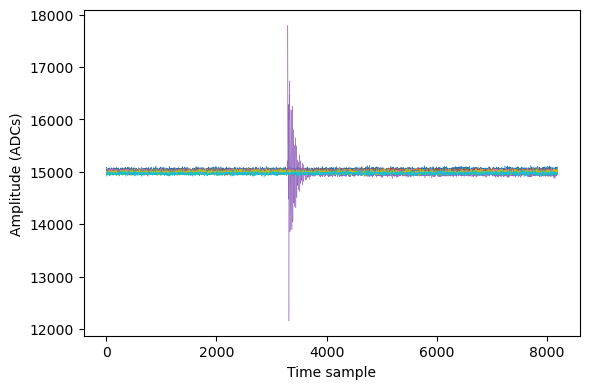

In [127]:
plt.figure(figsize=(6, 4))
for i in range(20):
    wf = data_raw.values[i]
    plt.plot(np.arange(len(wf)), wf, linewidth=0.3)
plt.xlabel('Time sample')
plt.ylabel('Amplitude (ADCs)')
plt.tight_layout()
plt.show()

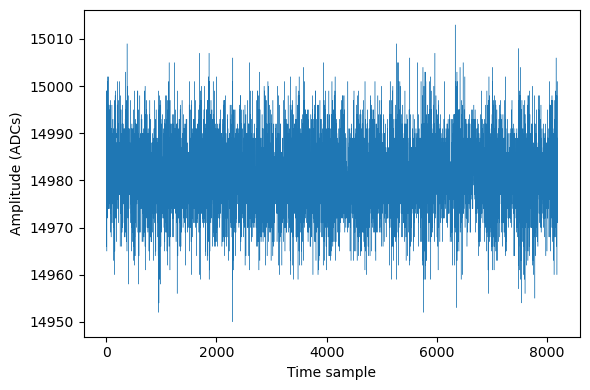

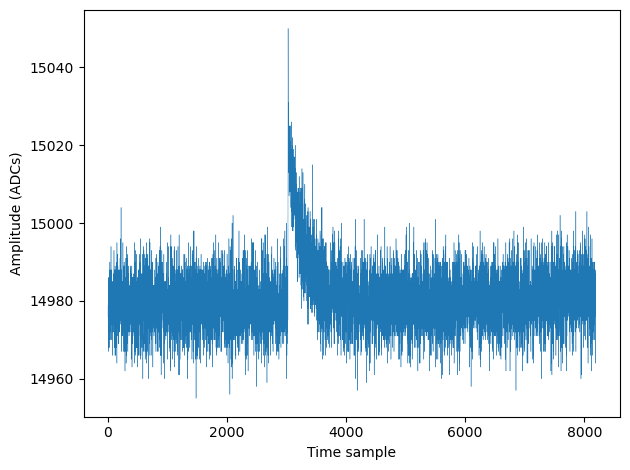

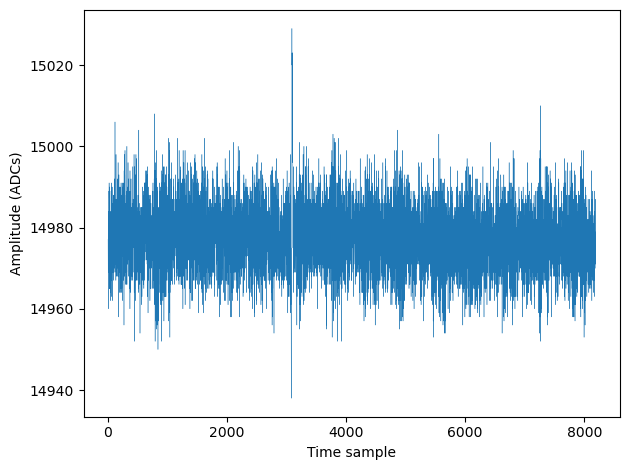

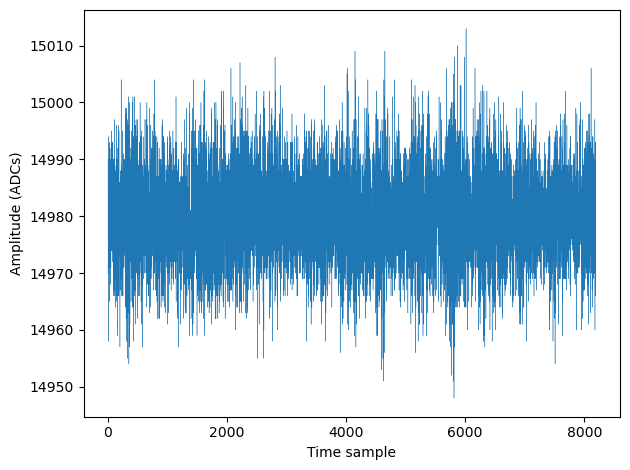

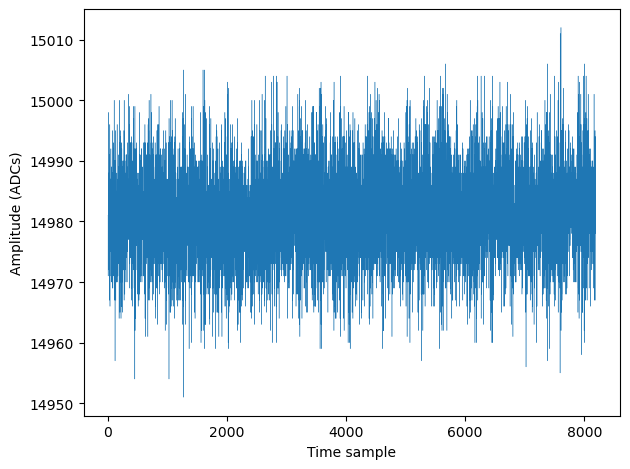

...

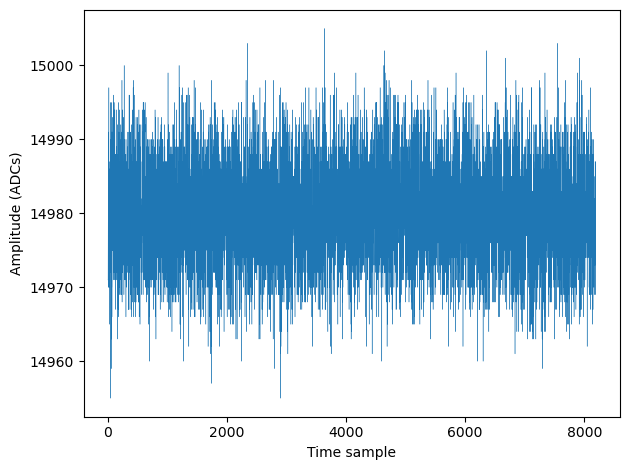

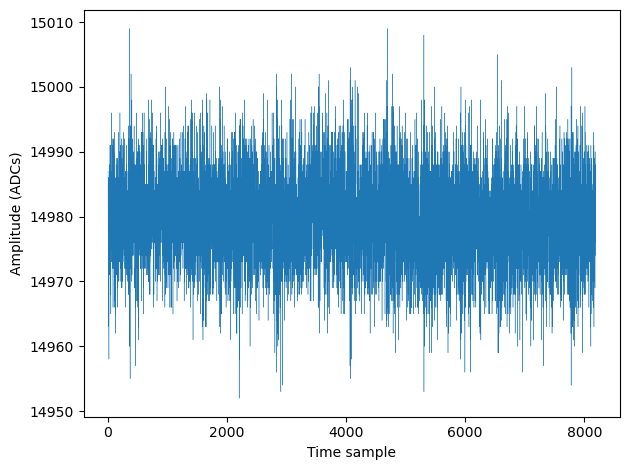

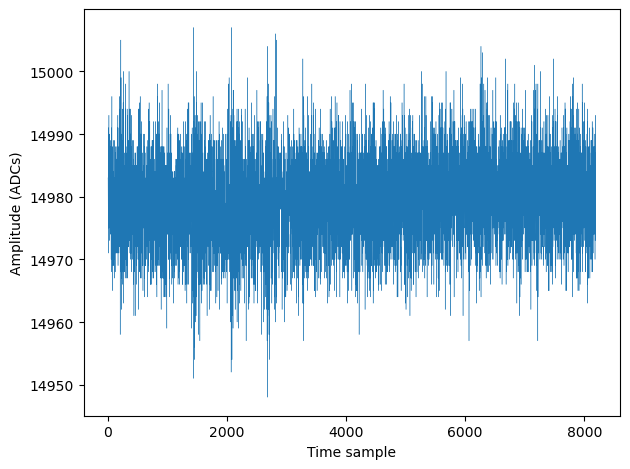

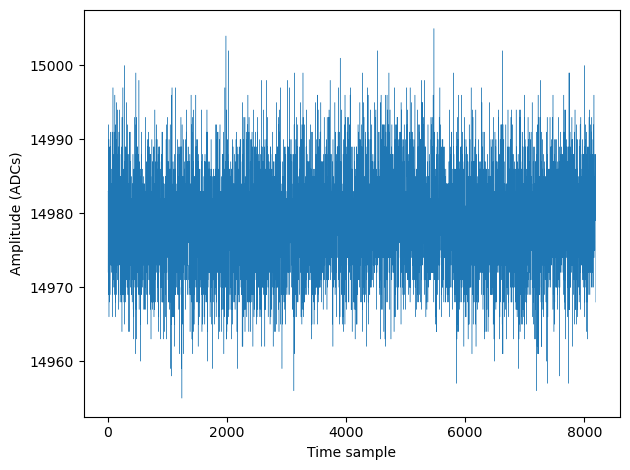

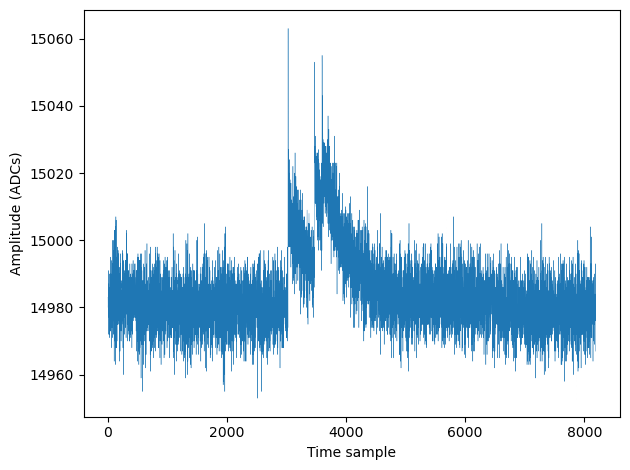

In [228]:
plt.figure(figsize=(6, 4))
for i in range(20, 40):
    wf = data_raw.values[i]
    plt.plot(np.arange(len(wf)), wf, linewidth=0.3)
    plt.xlabel('Time sample')
    plt.ylabel('Amplitude (ADCs)')
    plt.tight_layout()
    plt.show()

(array([0., 0., 0., ..., 1., 0., 0.]),
 array([14900., 14903., 14906., ..., 15194., 15197., 15200.]),
 <BarContainer object of 100 artists>)

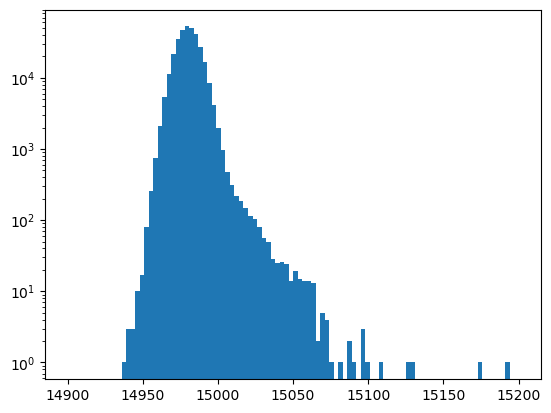

In [231]:
plt.hist(np.array([data_raw.values[i] for i in range(40)]).flatten(), bins=100, range=(14900, 15200), log=True)

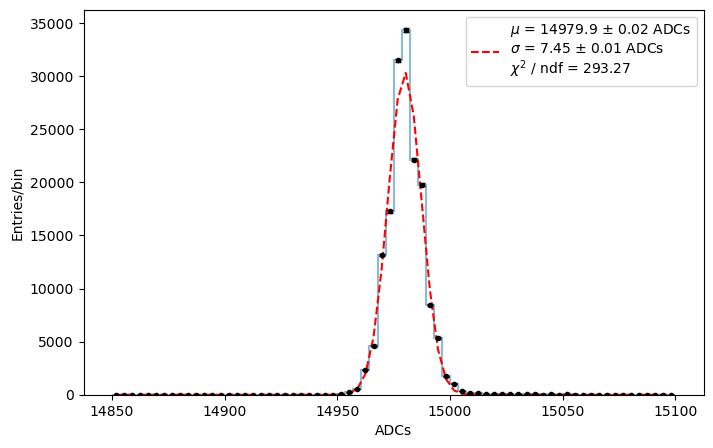

(14979.90286218155,
 0.019068261793599862,
 7.450102915441502,
 0.0147112498475411,
 17.544992365864736,
 0.03464499339095929,
 293.2747089946162)

In [227]:
fitf.gaussian_fit_IC(np.array([data_raw.values[i] for i in range(20)]).flatten(), bins=70, prange=(14850, 15100), 
                     ampl=10000, mean=14980, sigma=20, frange=(14950, 15000), title='', ndec=2, print_chi2=True)


### Ge

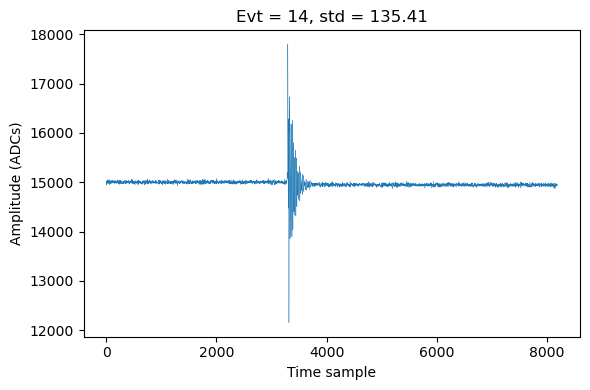

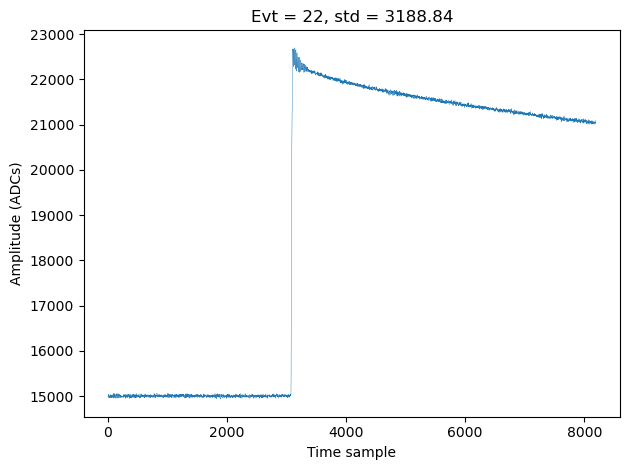

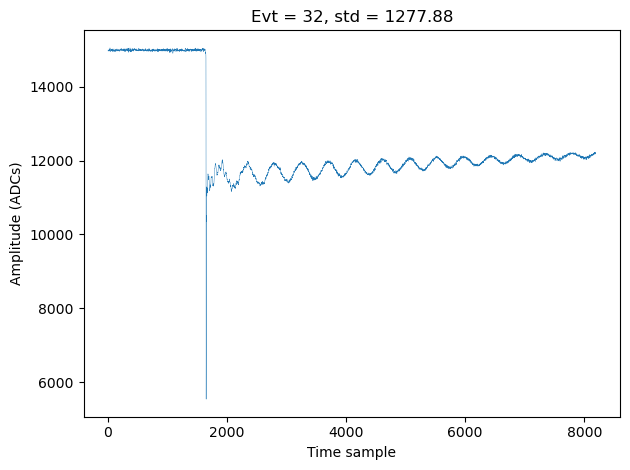

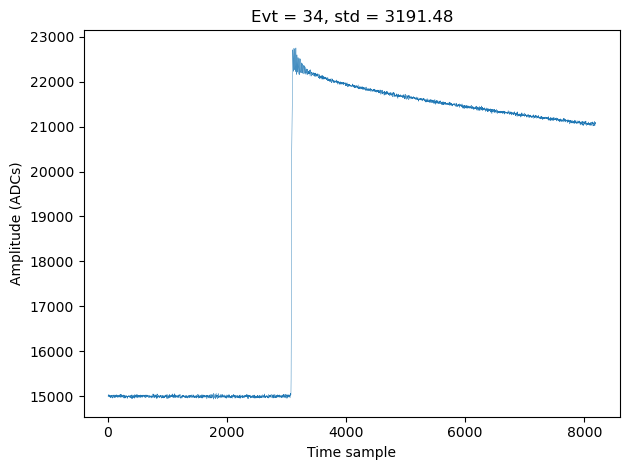

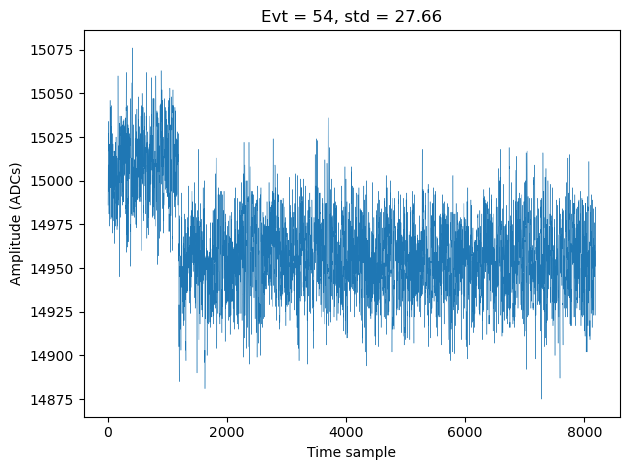

...

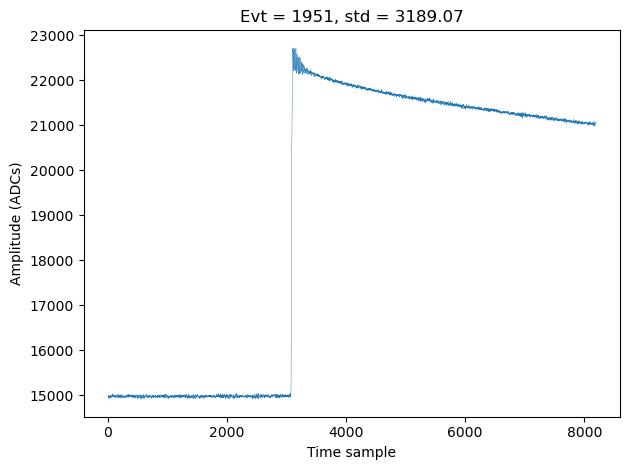

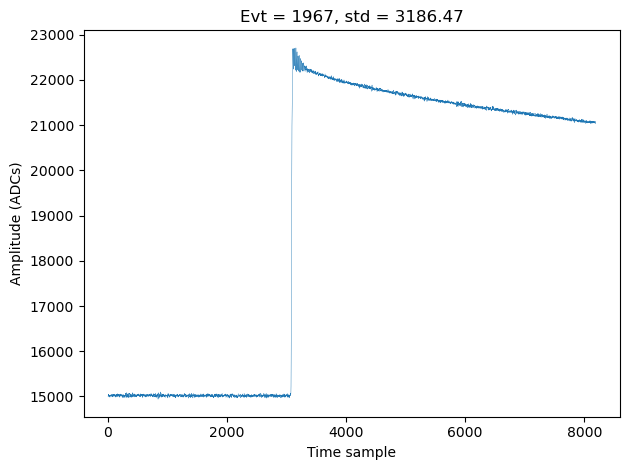

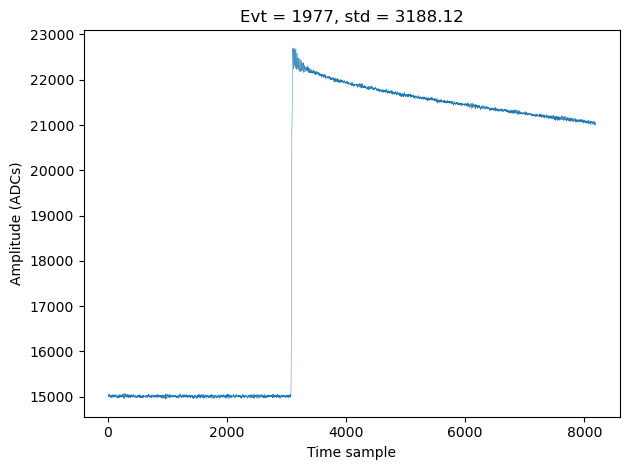

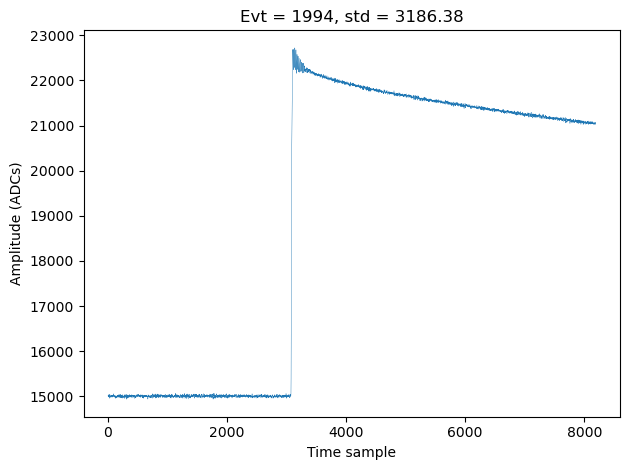

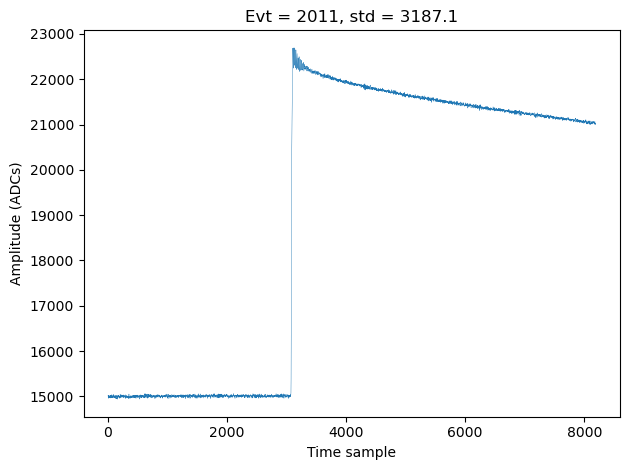

In [126]:
channel = 'ch1104000'
store   = LH5Store() 
data_raw, n_tot = store.read_object(f'{channel}/raw/waveform', wf_file, n_rows=np.inf)

plt.figure(figsize=(6, 4))
for i in range(len(data_raw.values)):
    wf = data_raw.values[i]
    if np.std(wf)>22:
        plt.plot(np.arange(len(wf)), wf, linewidth=0.3)
        plt.title(f'Evt = {i}, std = {np.round(np.std(wf), 2)}')
        plt.xlabel('Time sample')
        plt.ylabel('Amplitude (ADCs)')
        plt.tight_layout()
        plt.show()

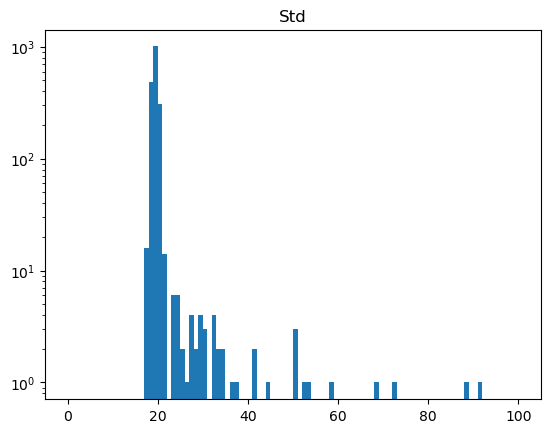

In [82]:
plt.hist([np.std(data_raw.values[i]) for i in range(len(data_raw.values))], bins=100, range=(0,100), log=True)
plt.title('Std');

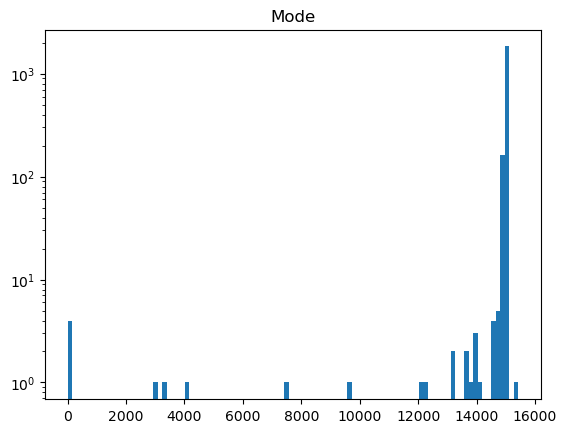

In [86]:
plt.hist([st.mode(data_raw.values[i], keepdims=False).mode for i in range(len(data_raw.values))], bins=100, log=True)
plt.title('Mode');



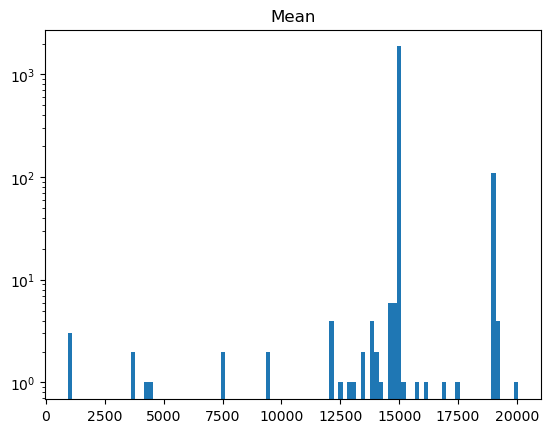

In [89]:
plt.hist([np.mean(data_raw.values[i]) for i in range(len(data_raw.values))], bins=100, log=True)
plt.title('Mean');

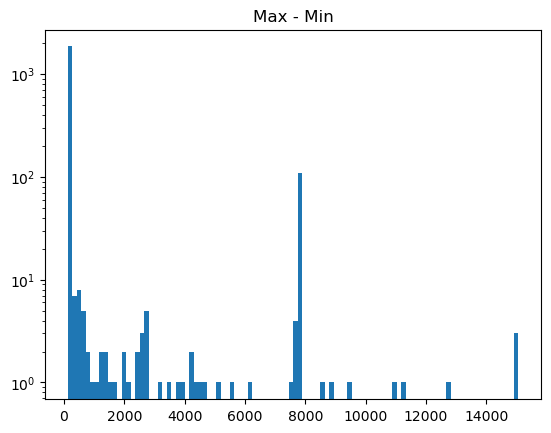

In [107]:
plt.hist([np.max(data_raw.values[i])-np.min(data_raw.values[i]) for i in range(len(data_raw.values))], bins=100, log=True)
plt.title('Max - Min');

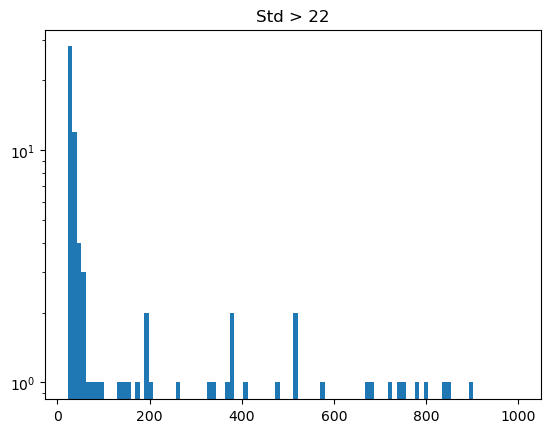

In [104]:
plt.hist([np.std(data_raw.values[i]) for i in range(len(data_raw.values))], bins=100, range=(22,1000), log=True)
plt.title('Std > 22');

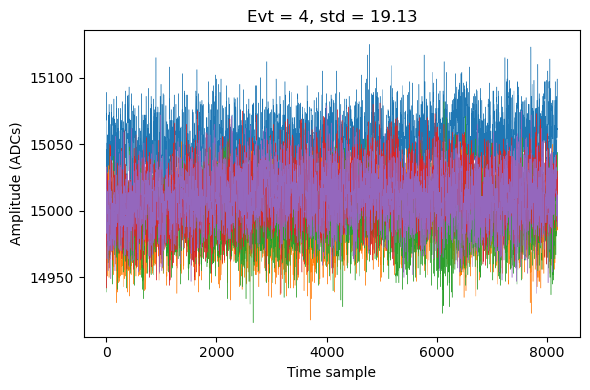

In [125]:
channel = 'ch1104000'
store   = LH5Store() 
data_raw, n_tot = store.read_object(f'{channel}/raw/waveform', wf_file, n_rows=np.inf)

plt.figure(figsize=(6, 4))
for i in range(len(data_raw.values))[:5]:
    wf = data_raw.values[i]
    if np.std(wf)<22:
        plt.plot(np.arange(len(wf)), wf, linewidth=0.3)
plt.title(f'Evt = {i}, std = {np.round(np.std(wf), 2)}')
plt.xlabel('Time sample')
plt.ylabel('Amplitude (ADCs)')
plt.tight_layout()
plt.show()

In [62]:
from sklearn.linear_model import LinearRegression

def calculate_baseline_slope(waveform):
    x = range(len(waveform))  # Time or sample index
    x = np.array(x).reshape(-1, 1)  # Reshape for regression
    y = waveform  # Baseline waveform values

    model = LinearRegression()
    model.fit(x, y)

    baseline_slope = model.coef_[0]
    return baseline_slope

0.0026607744217418496


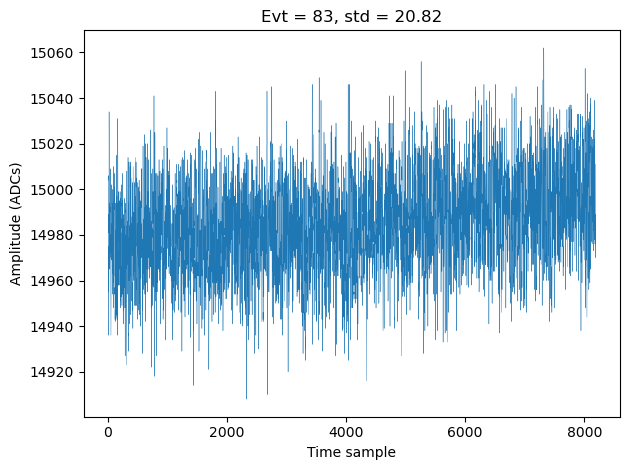

0.0020934006809495936


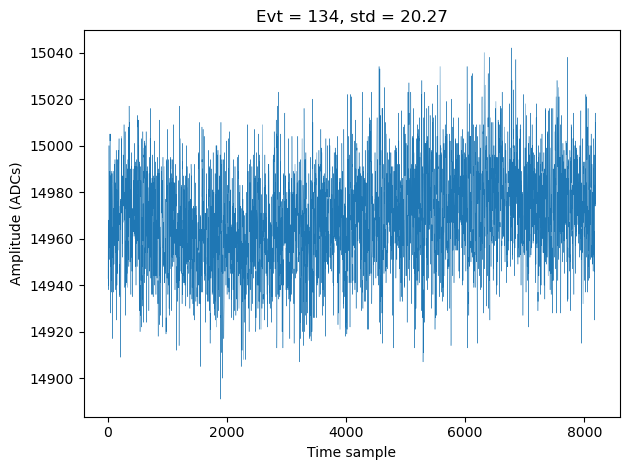

0.00221312613963151


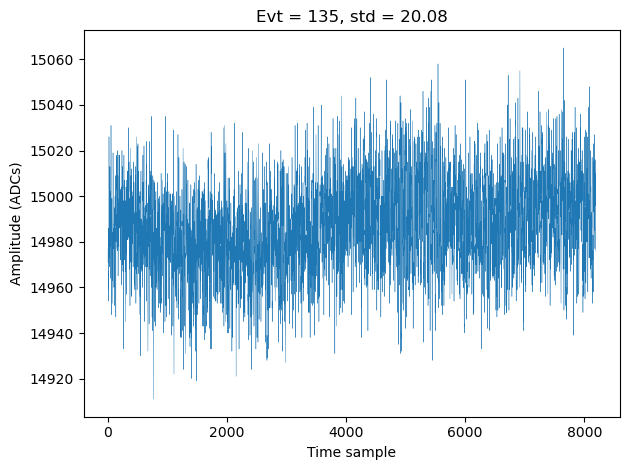

0.0021516095177975944


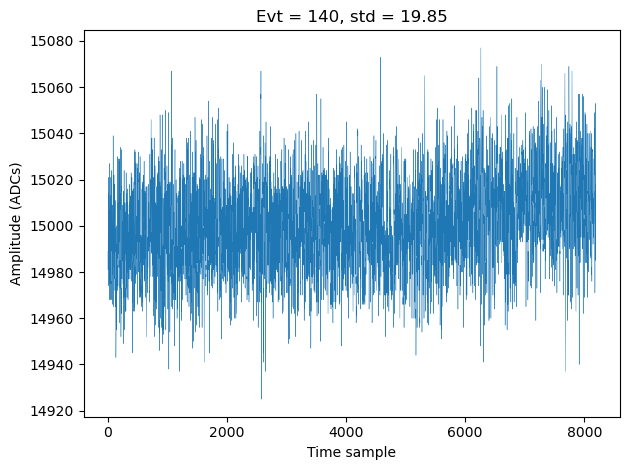

0.0025067987817887012


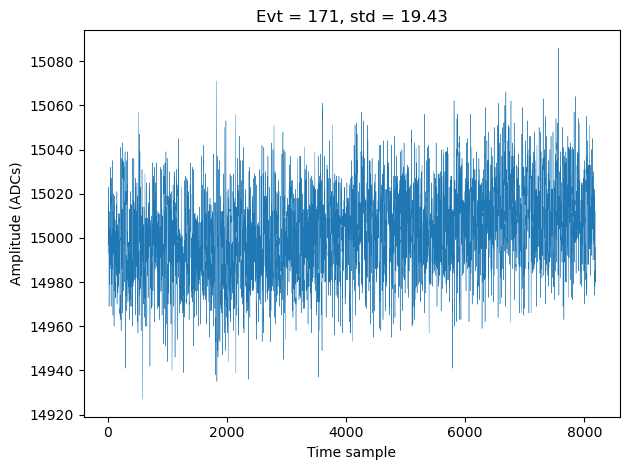

0.002001123412616292


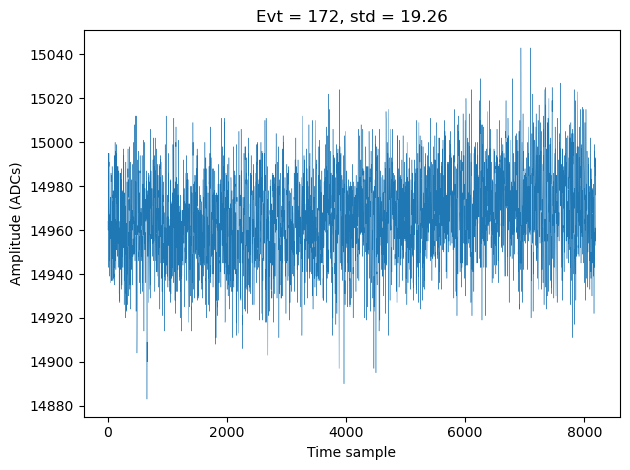

0.0023218144324715514


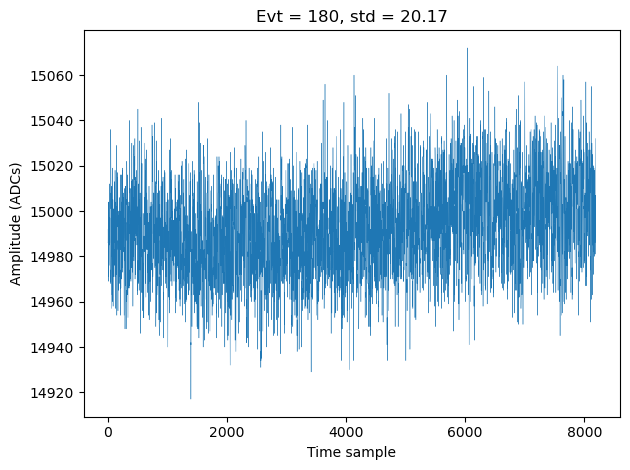

0.002286443717331249


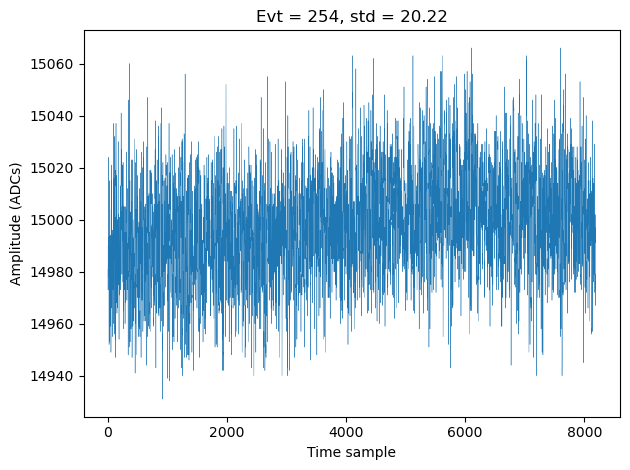

0.002020935459869183


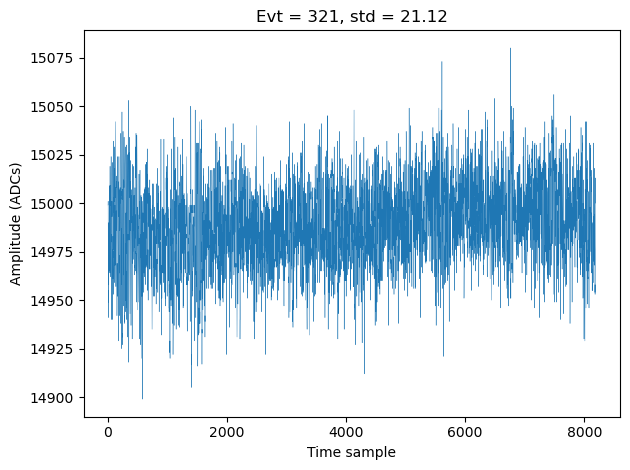

0.0021900057944376863


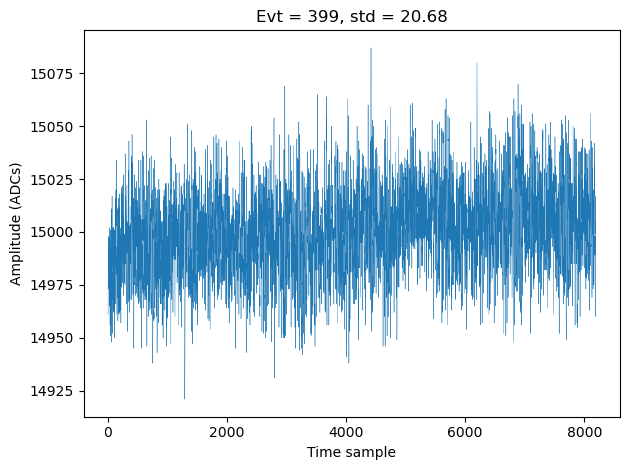

0.0022033952301175534


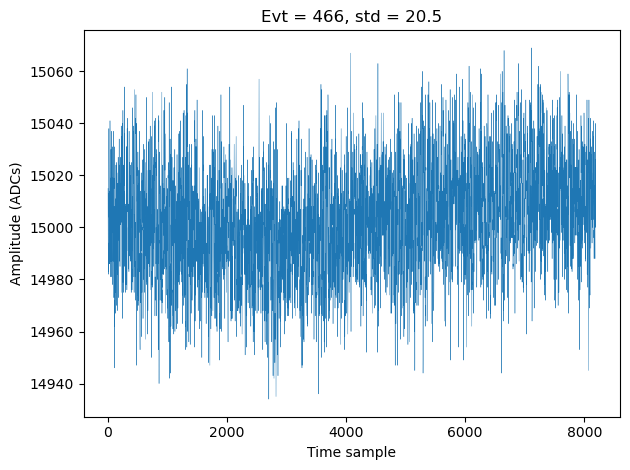

0.0021353165711707547


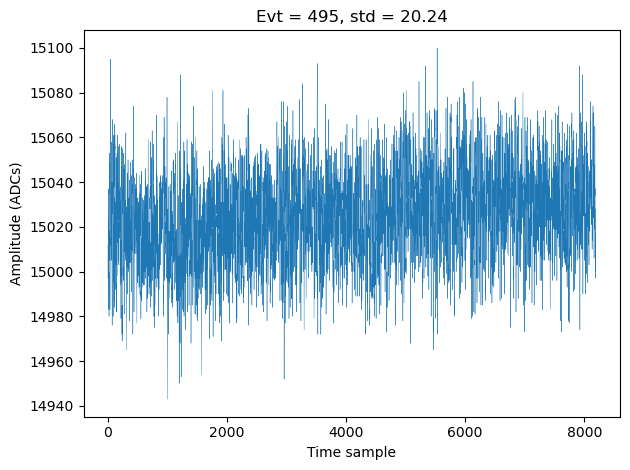

0.0021085558933433067


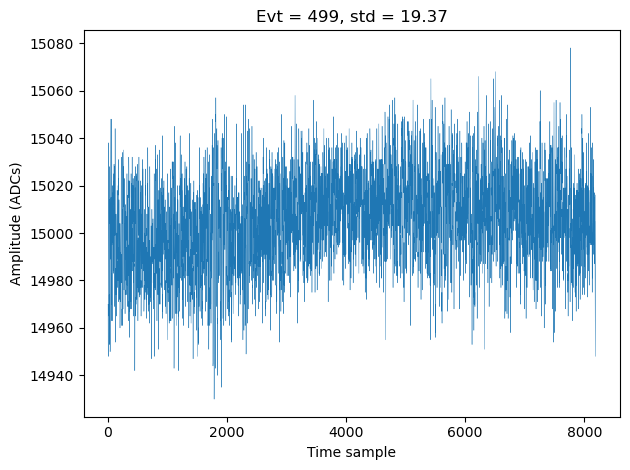

0.0022858537535752703


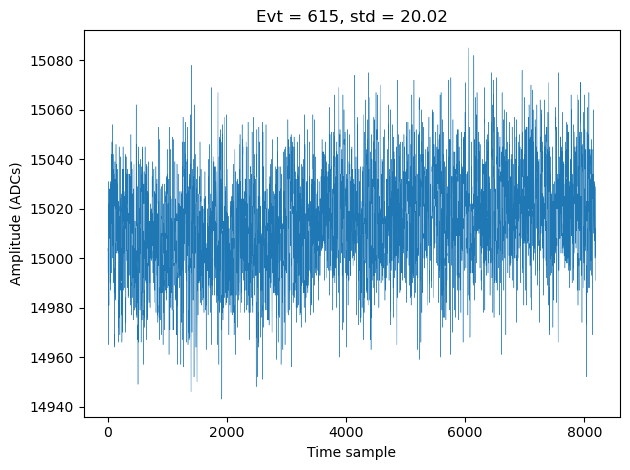

0.0021726455521244347


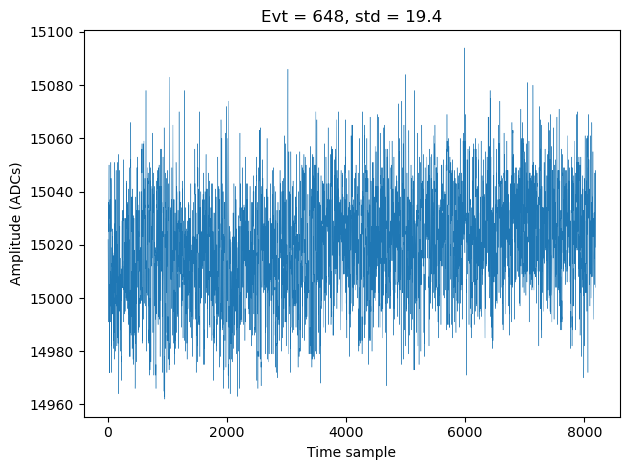

0.0026377156638921675


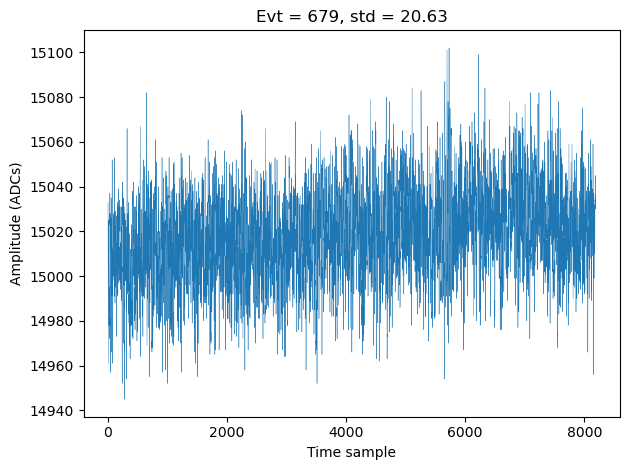

0.0024726490523897878


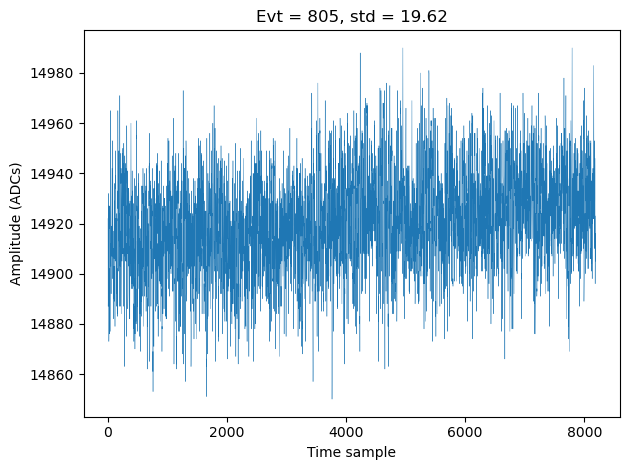

0.0021729862743106476


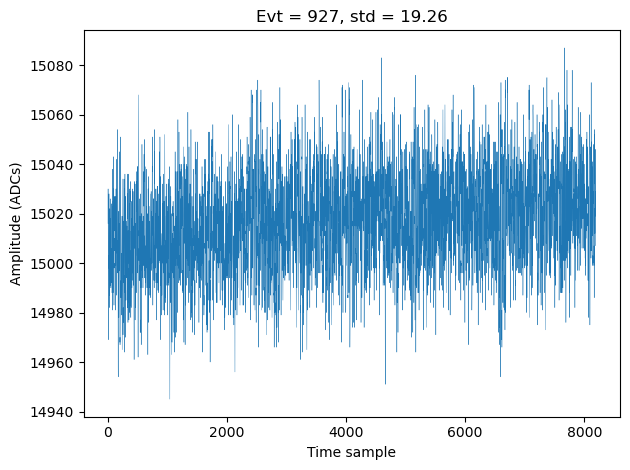

0.002421311619101077


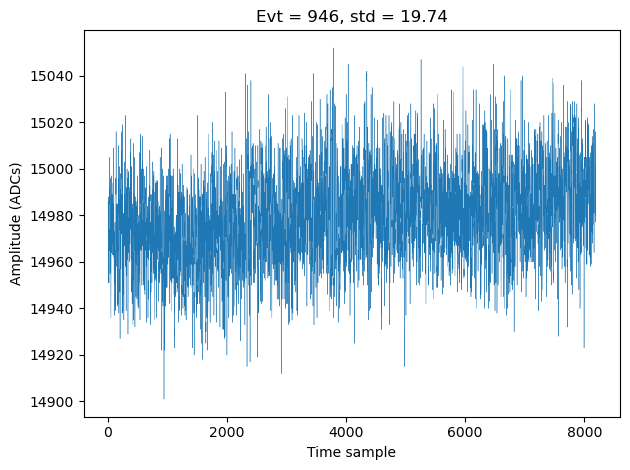

0.0021363639489229034


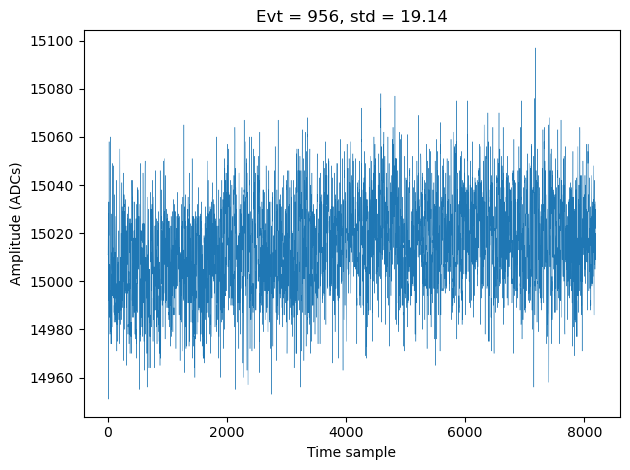

0.0028556376408112208


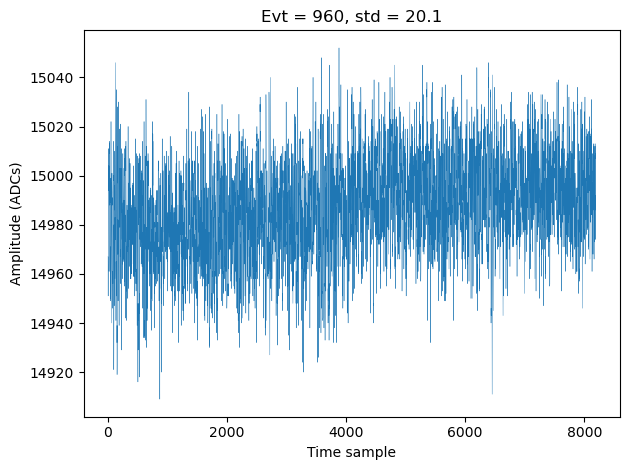

0.0025909002674318867


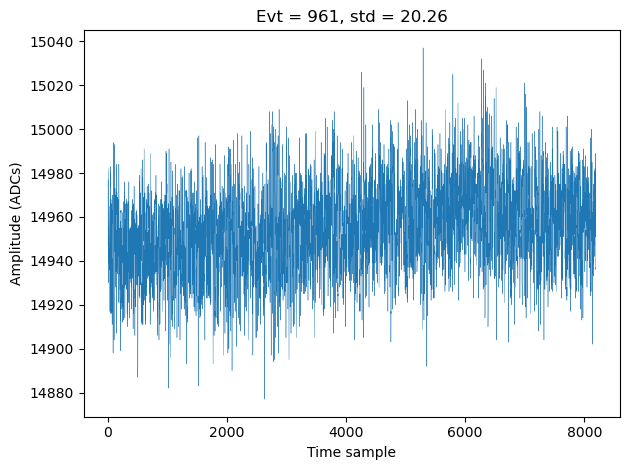

0.0020545434760257534


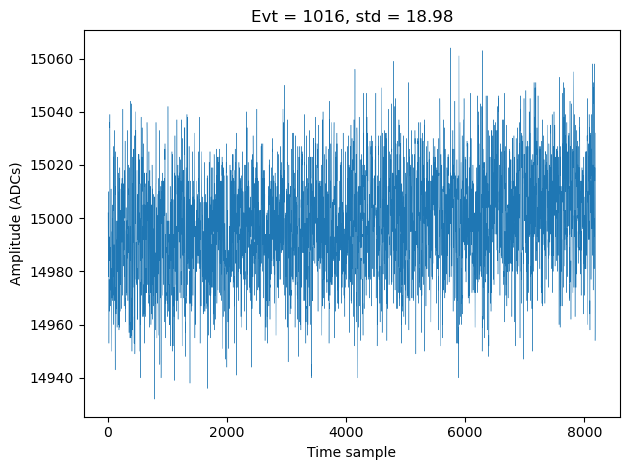

0.0024461162793860845


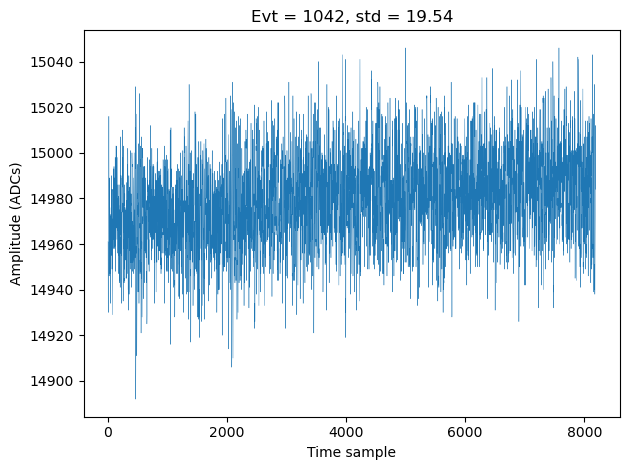

0.002800408592412979


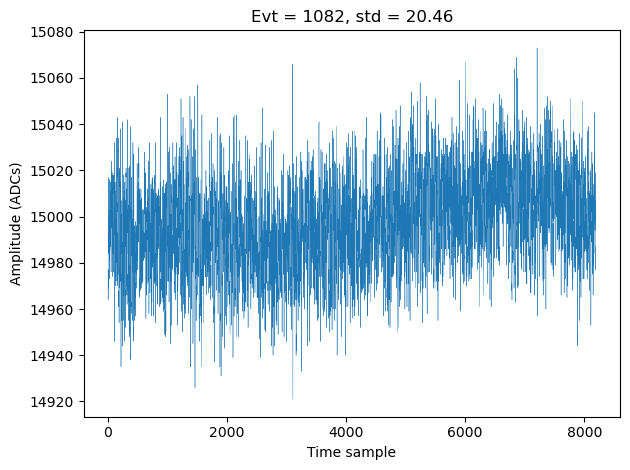

0.0021010747608888837


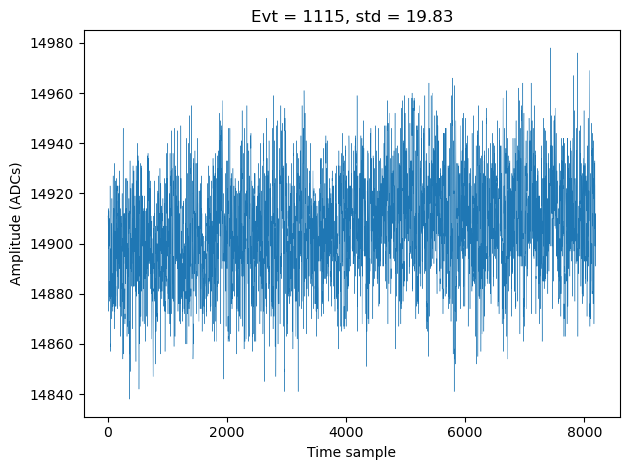

0.0022999240770167984


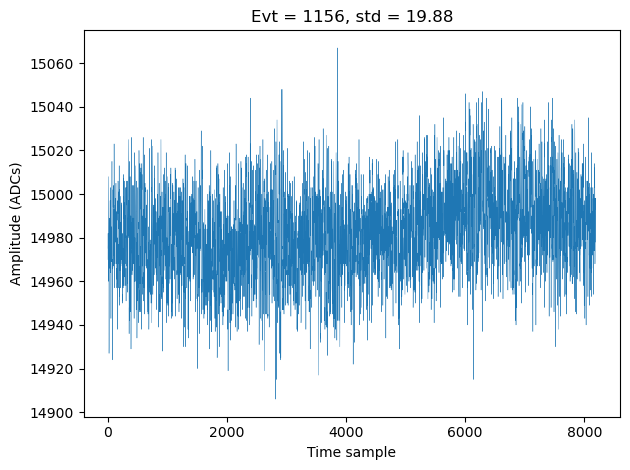

0.0030726698481363377


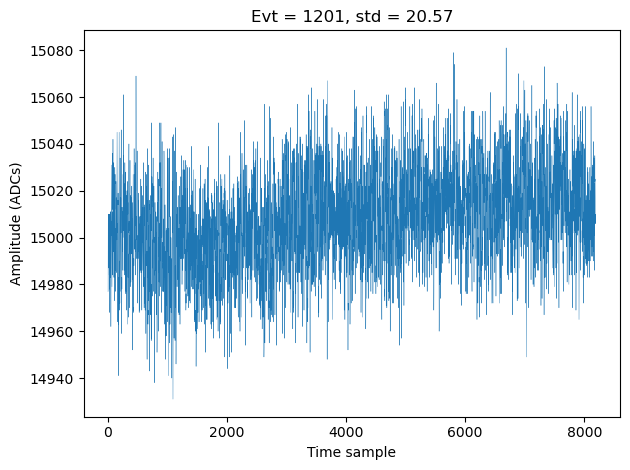

0.0029470215270375744


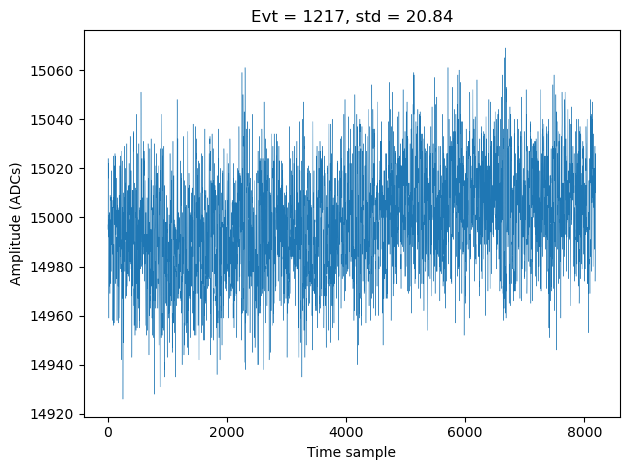

0.002175924557059575


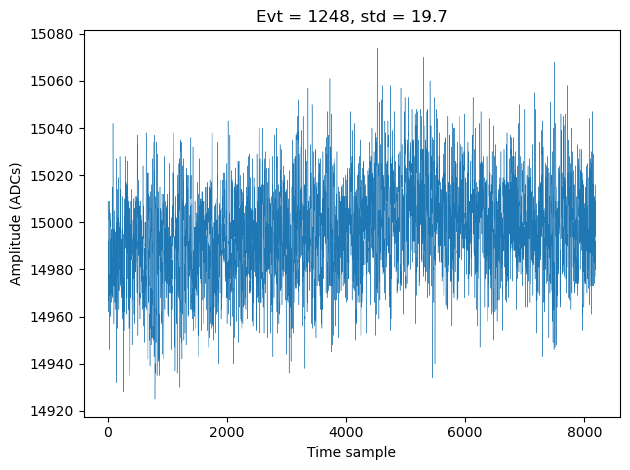

0.0028119860308575655


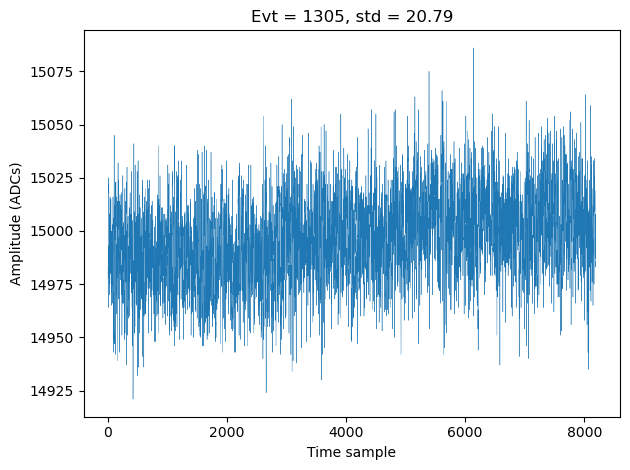

0.002377383810154291


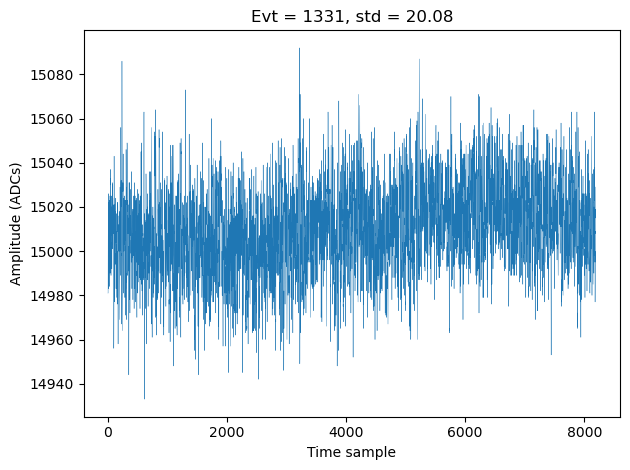

0.002278820594561871


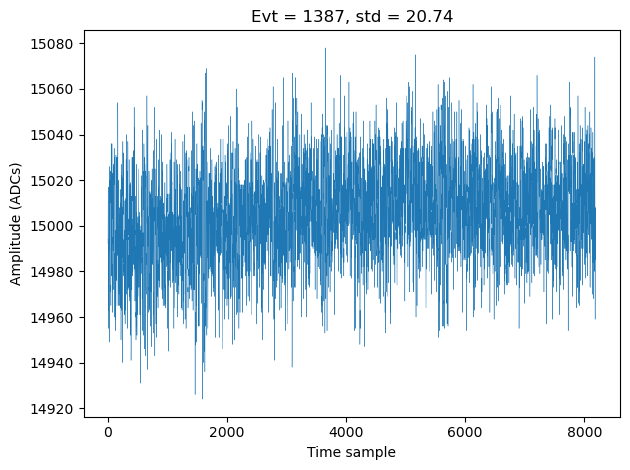

0.0028862694155474275


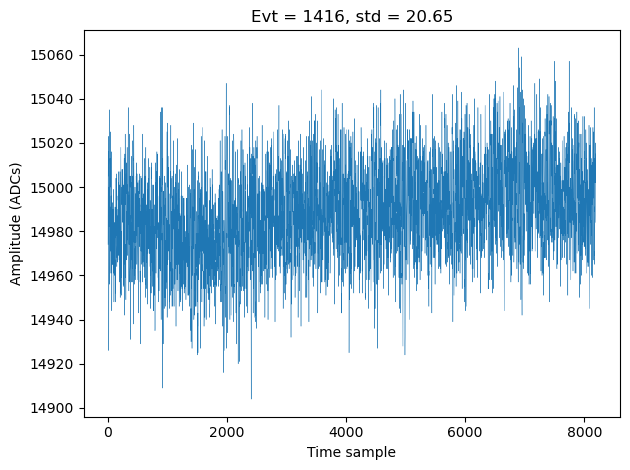

0.003177458045738122


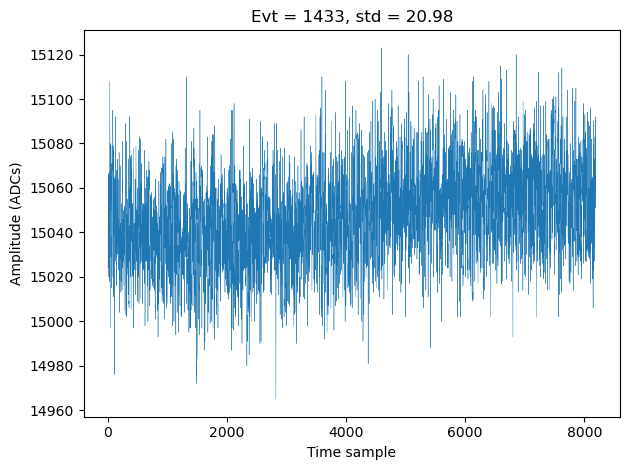

0.0020609902837961844


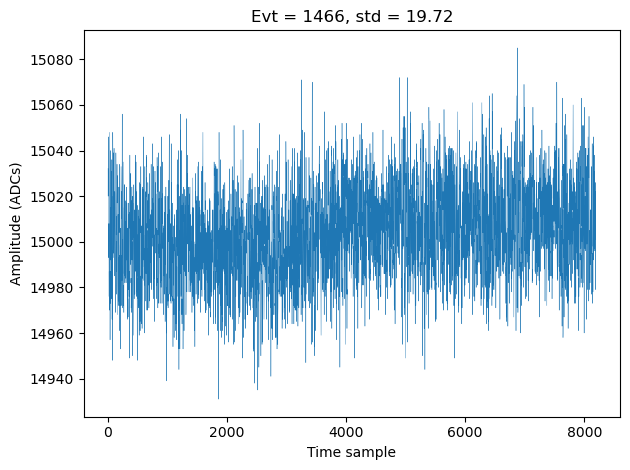

0.002149292554544452


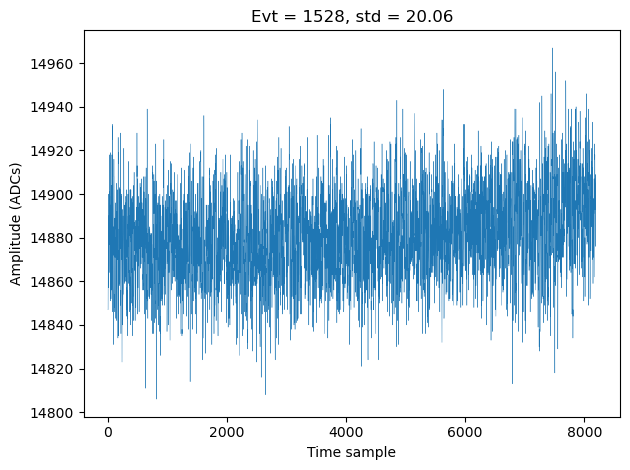

0.002756511964583014


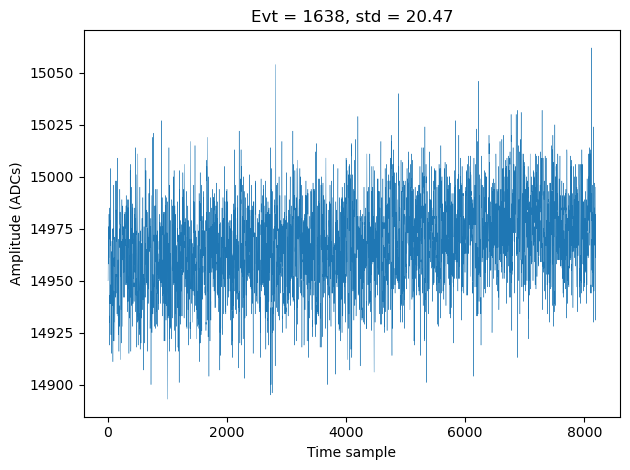

0.0021704516871620203


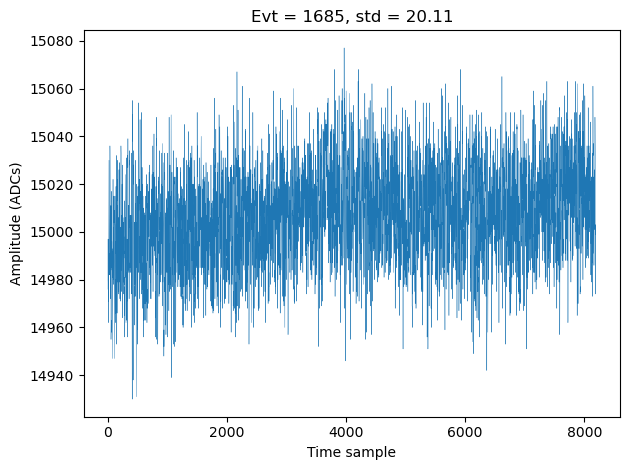

0.0022231632287223915


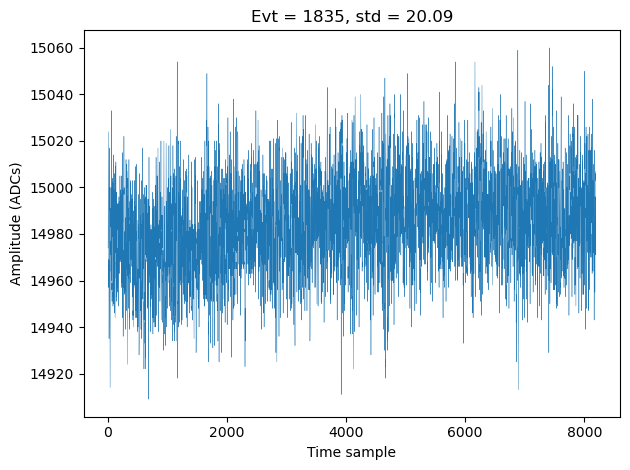

0.002125964135149656


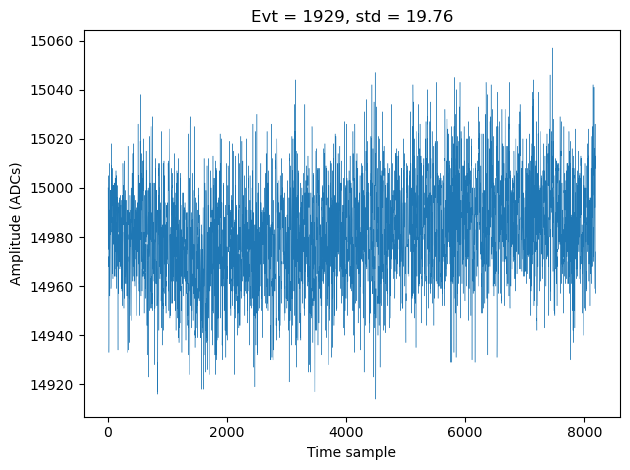

0.002447126058626699


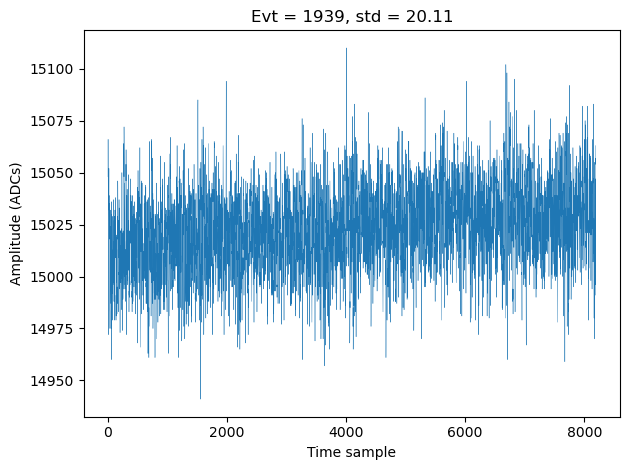

0.0022019118187710054


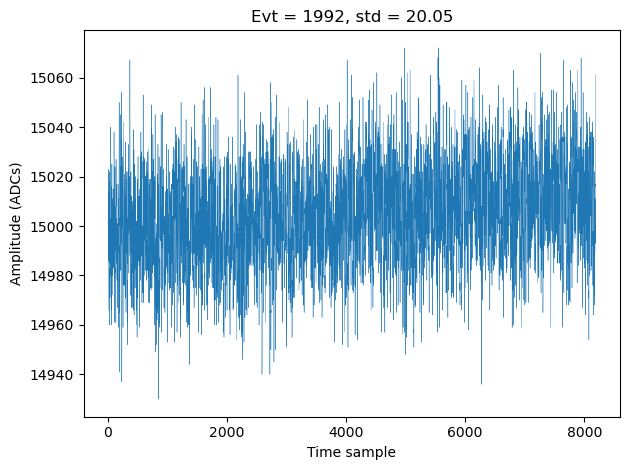

0.0020516149285082583


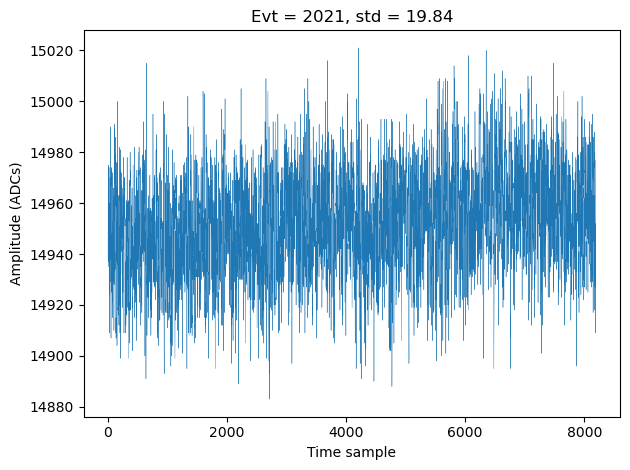

In [124]:
for i in range(len(data_raw.values)):
    wf = data_raw.values[i]
    slope = calculate_baseline_slope(wf)
    if np.std(wf)<22:
        if slope >= 0.002:
            print(slope)
            plt.plot(np.arange(len(wf)), wf, linewidth=0.3)
            plt.title(f'Evt = {i}, std = {np.round(np.std(wf), 2)}')
            plt.xlabel('Time sample')
            plt.ylabel('Amplitude (ADCs)')
            plt.tight_layout()
            plt.show()

In [73]:
all_slopes = np.array([calculate_baseline_slope(data_raw.values[i]) 
                       for i in range(len(data_raw.values)) if np.std(data_raw.values[i]) < 22])

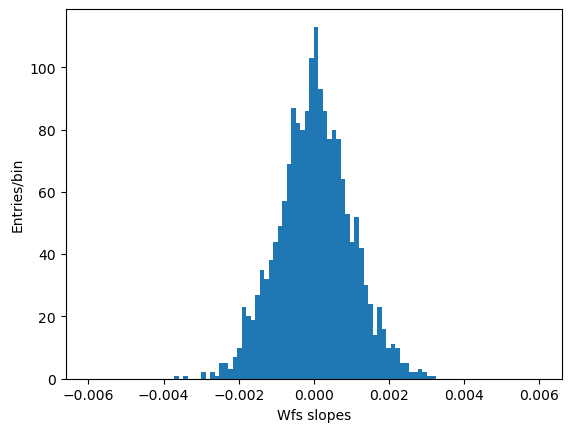

In [79]:
plt.hist(all_slopes, bins=100, range=(-0.006, 0.006))
plt.xlabel('Wfs slopes')
plt.ylabel('Entries/bin');

### For each wf which is not only baseline, let's see the values of mode, mean and std

In [110]:
def string_stats(waveform, units='ADCs', ndec=2):
    std_str     = f'Std   = {np.round(np.std(waveform), ndec)} {units}'
    mean_str    = f'Mean  = {np.round(np.mean(waveform), ndec)} {units}'
    mode_str    = f'Mode  = {np.round(st.mode(waveform, keepdims=False).mode, ndec)} {units}'
    slope_str   = f'Slope = {np.round(calculate_baseline_slope(waveform), 5)} {units}'
    max_min_str = f'Max - Min = {np.round(np.max(waveform)-np.min(waveform), ndec)} {units}'
    return f'{std_str}'+'\n'+f'{mean_str}'+'\n'+f'{mode_str}'+'\n'+f'{slope_str}'+'\n'+f'{max_min_str}'

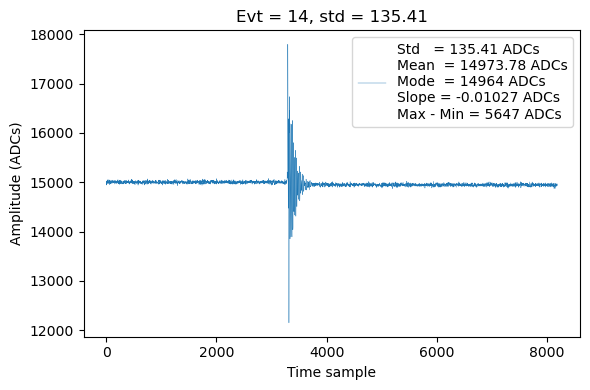

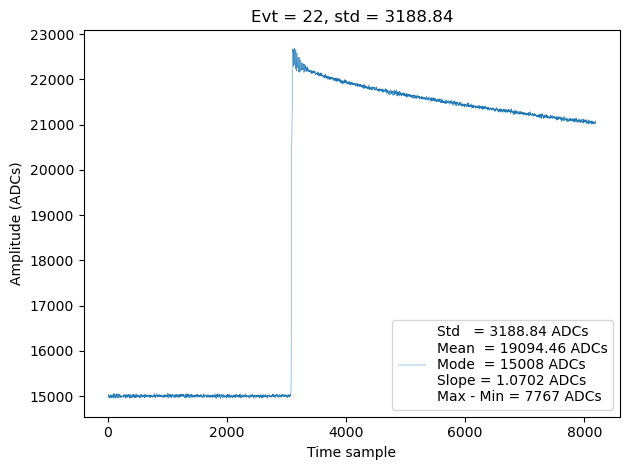

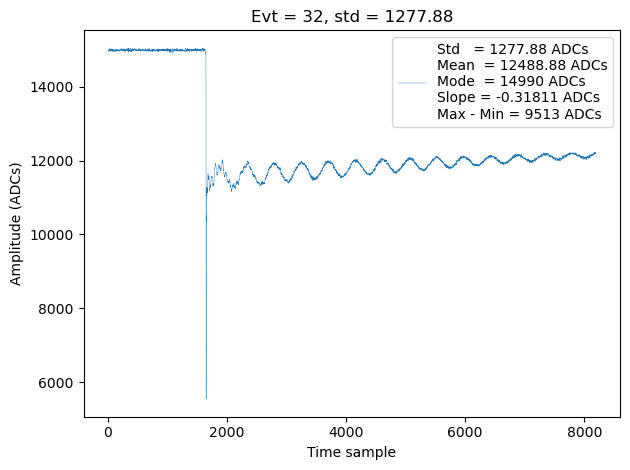

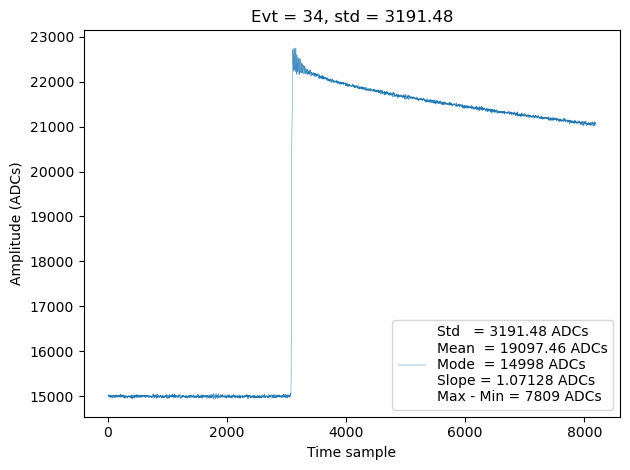

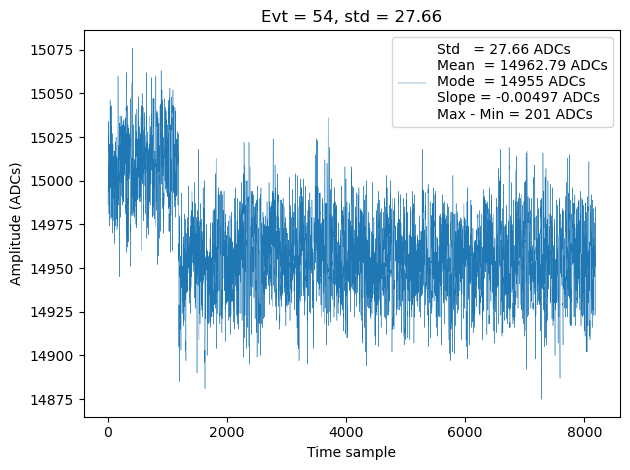

...

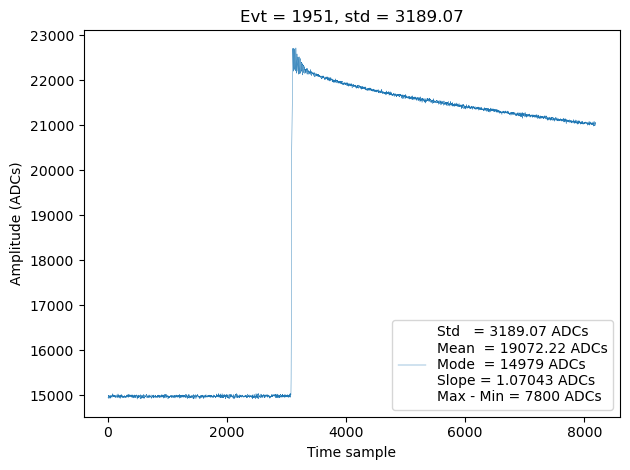

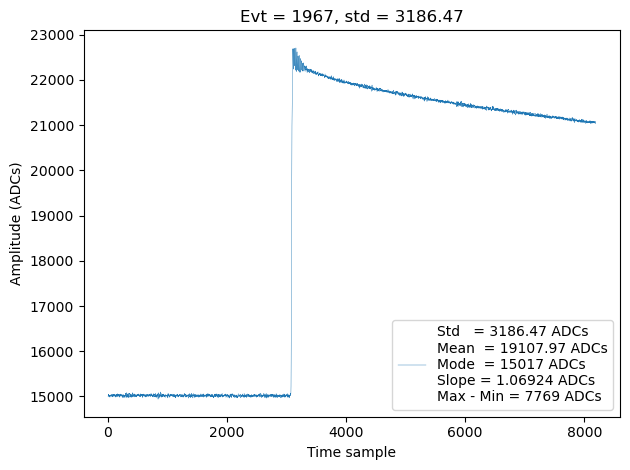

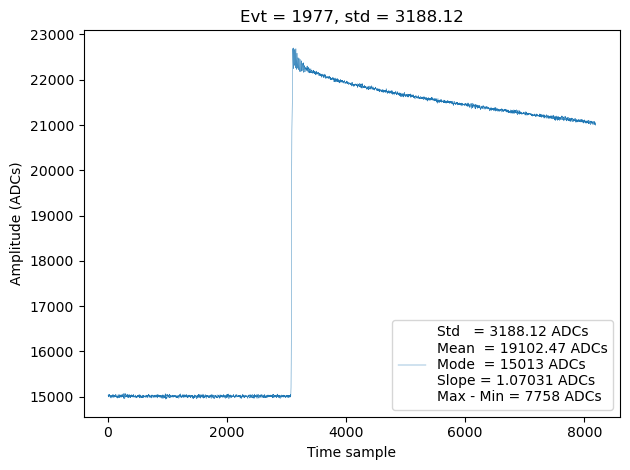

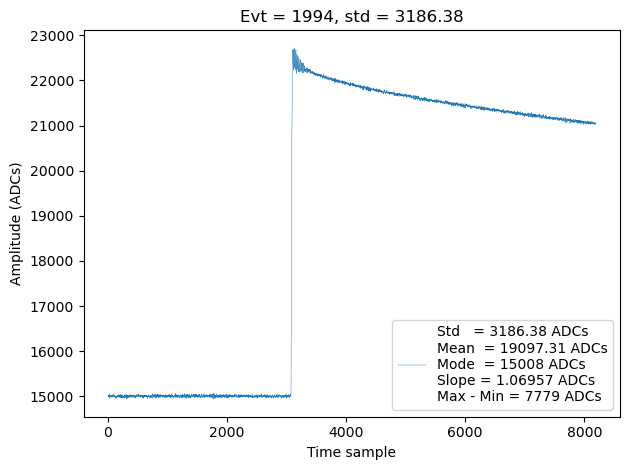

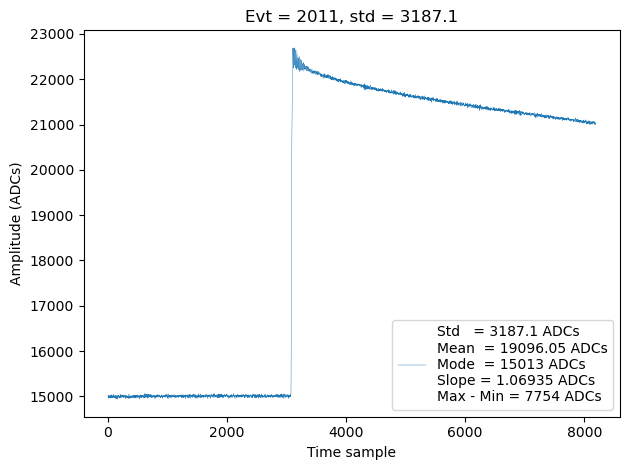

In [123]:
channel = 'ch1104000'
store   = LH5Store() 
data_raw, n_tot = store.read_object(f'{channel}/raw/waveform', wf_file, n_rows=np.inf)

plt.figure(figsize=(6, 4))
for i in range(len(data_raw.values)):
    wf = data_raw.values[i]
    if np.std(wf)>22:
        plt.plot(np.arange(len(wf)), wf, linewidth=0.3, label=string_stats(wf))
        plt.title(f'Evt = {i}, std = {np.round(np.std(wf), 2)}')
        plt.xlabel('Time sample')
        plt.ylabel('Amplitude (ADCs)')
        plt.legend()
        plt.tight_layout()
        plt.show()

### Data selection:

- 22 < Std < 100
- Max - Min < 250
- Slope > 0
- Mean > 14800

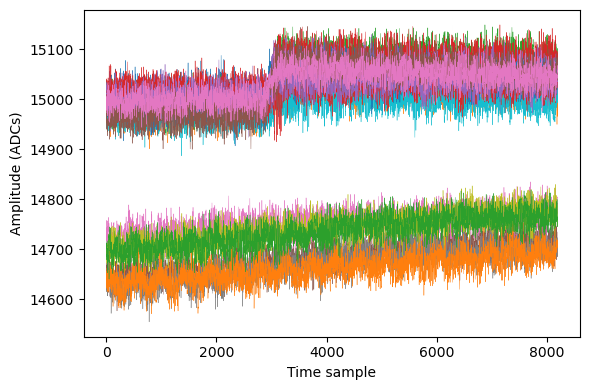

In [136]:
channel = 'ch1104000'
store   = LH5Store() 
data_raw, n_tot = store.read_object(f'{channel}/raw/waveform', wf_file, n_rows=np.inf)

plt.figure(figsize=(6, 4))
for i in range(len(data_raw.values)):
    wf = data_raw.values[i]
    if np.std(wf)>22 and np.std(wf)<100:
        slope = calculate_baseline_slope(wf)
        if slope > 0:
            max_min = np.max(wf) - np.min(wf)
            if max_min < 250:
                plt.plot(np.arange(len(wf)), wf, linewidth=0.3, label=f"Evt = {i}")
#plt.ylim(14880, 15160)
plt.xlabel('Time sample')
plt.ylabel('Amplitude (ADCs)')
#plt.legend()
plt.tight_layout()
plt.show()

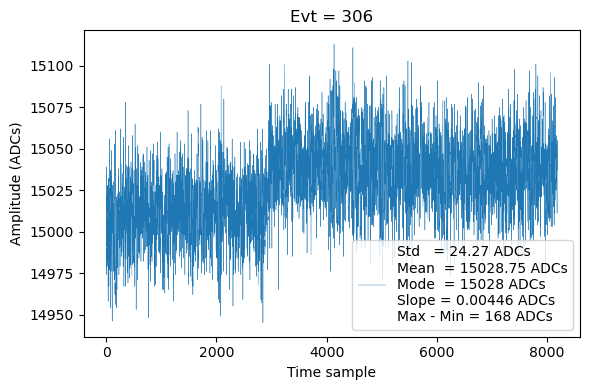

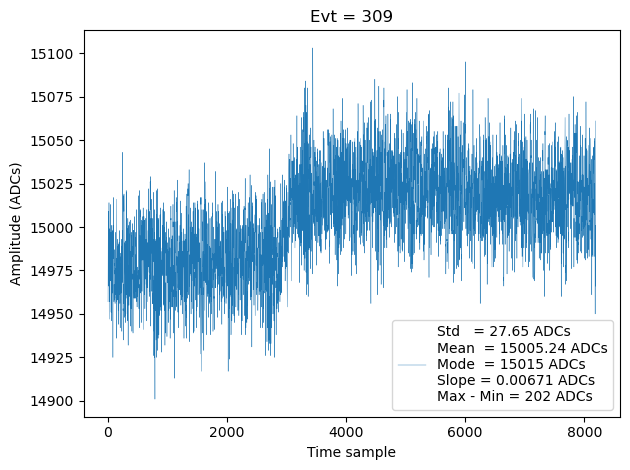

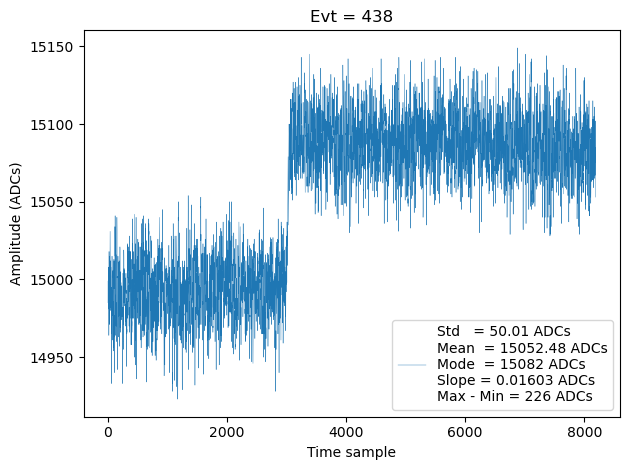

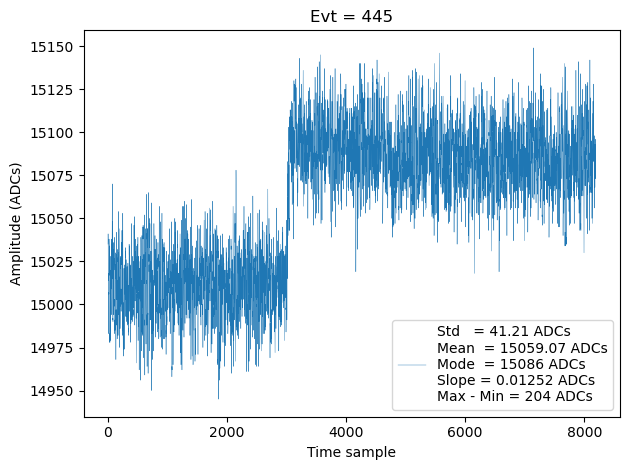

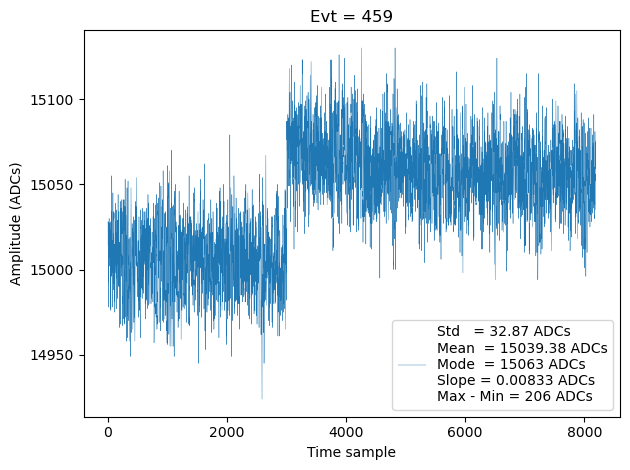

...

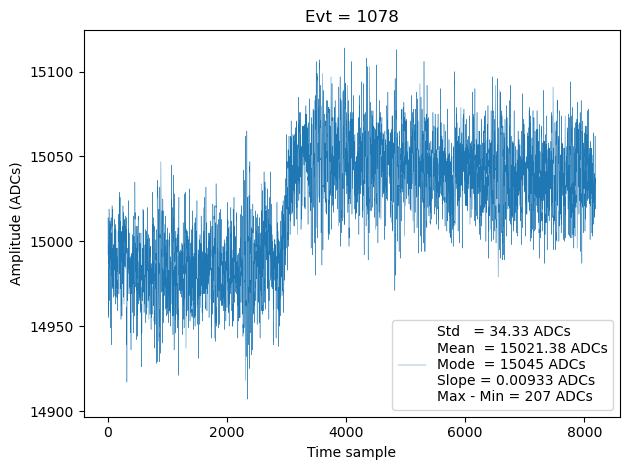

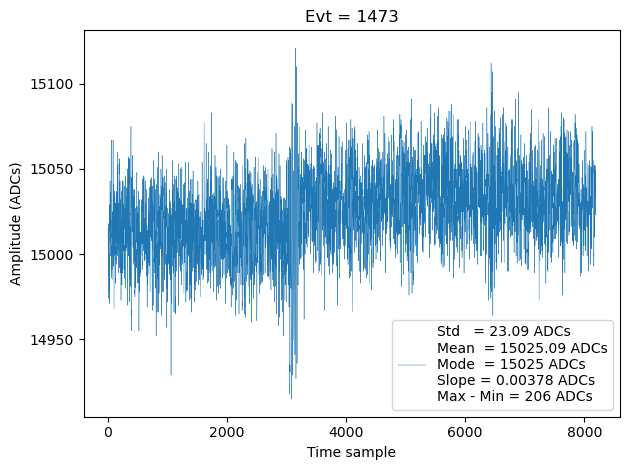

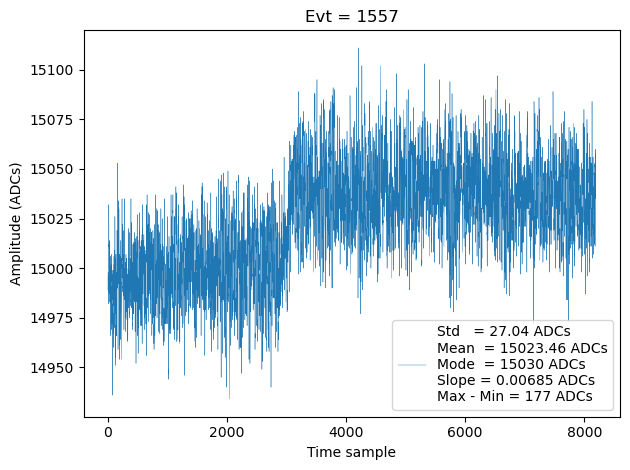

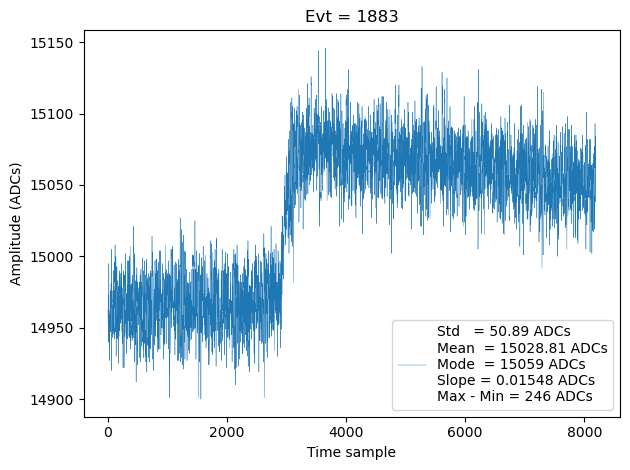

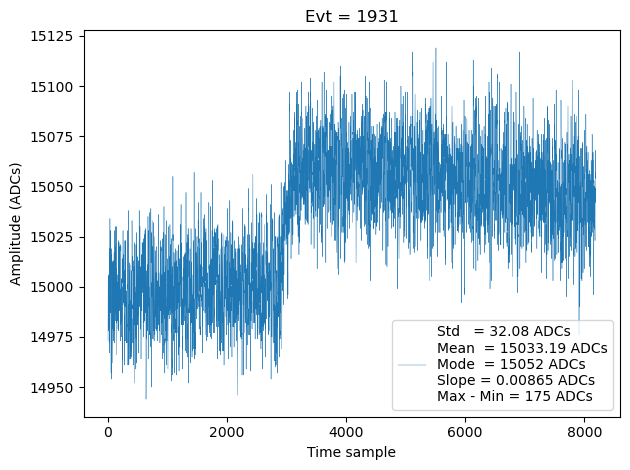

In [166]:
channel = 'ch1104000'
store   = LH5Store() 
data_raw, n_tot = store.read_object(f'{channel}/raw/waveform', wf_file, n_rows=np.inf)

plt.figure(figsize=(6, 4))
for i in range(len(data_raw.values)):
    wf = data_raw.values[i]
    if np.std(wf)>22 and np.std(wf)<100:
        slope = calculate_baseline_slope(wf)
        if slope > 0:
            max_min = np.max(wf) - np.min(wf)
            if max_min < 250:
                if np.mean(wf)>14800:
                    plt.plot(np.arange(len(wf)), wf, linewidth=0.3, label=string_stats(wf))
                    plt.title(f'Evt = {i}')
                    plt.xlabel('Time sample')
                    plt.ylabel('Amplitude (ADCs)')
                    plt.legend()
                    plt.tight_layout()
                    plt.show()

### Ascending evts:

In [ ]:
497, 498, 542, 543, 1366

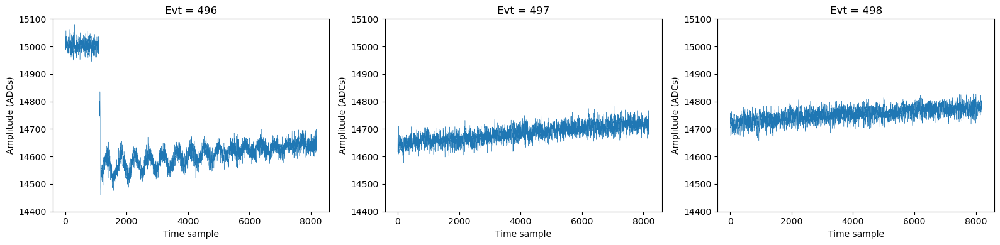

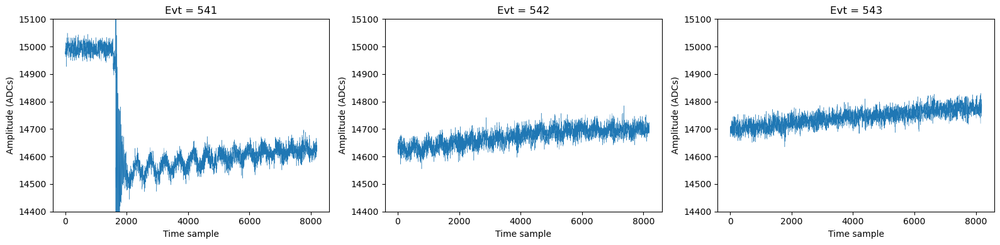

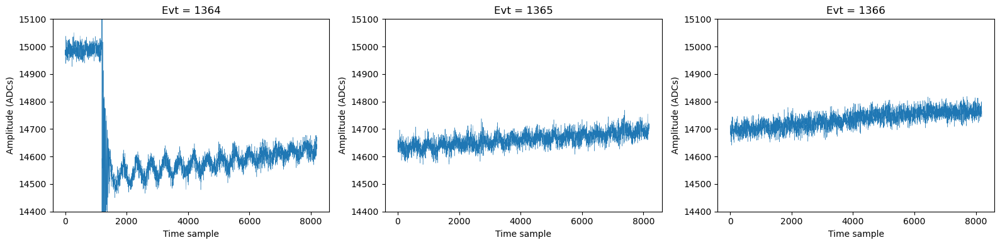

In [147]:
for evt in [497, 542, 1365]:
    fig, axs = plt.subplots(1, 3, figsize=(16, 4))
    for ax, add_val in zip(axs, [-1, 0, 1]):
        ax.plot(np.arange(len(data_raw.values[evt+add_val])), data_raw.values[evt+add_val], linewidth=0.3)
        ax.set_ylim(14400, 15100)
        ax.set_title(f'Evt = {evt+add_val}')
        ax.set_xlabel('Time sample')
        ax.set_ylabel('Amplitude (ADCs)')
    plt.tight_layout()

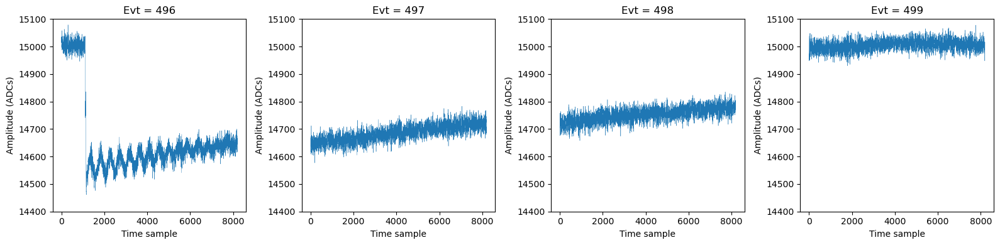

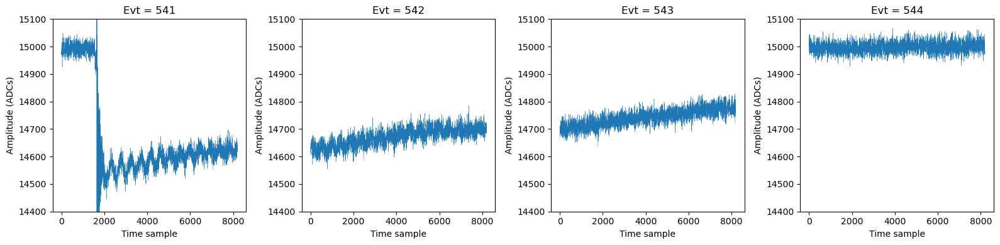

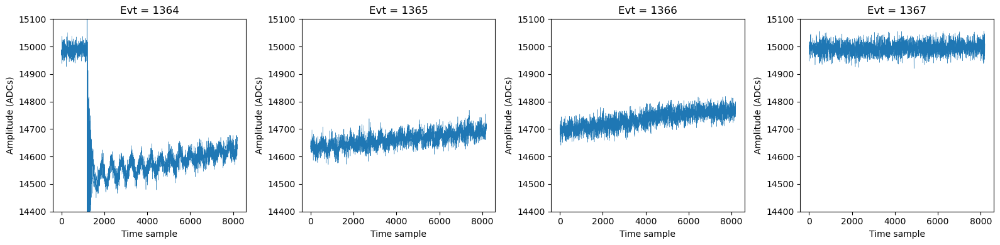

In [148]:
for evt in [497, 542, 1365]:
    fig, axs = plt.subplots(1, 4, figsize=(16, 4))
    for ax, add_val in zip(axs, [-1, 0, 1, 2]):
        ax.plot(np.arange(len(data_raw.values[evt+add_val])), data_raw.values[evt+add_val], linewidth=0.3, label=string_stats(wf))
        ax.set_ylim(14400, 15100)
        ax.set_title(f'Evt = {evt+add_val}')
        ax.set_xlabel('Time sample')
        ax.set_ylabel('Amplitude (ADCs)')
    plt.tight_layout()

## Check the other Ge channel

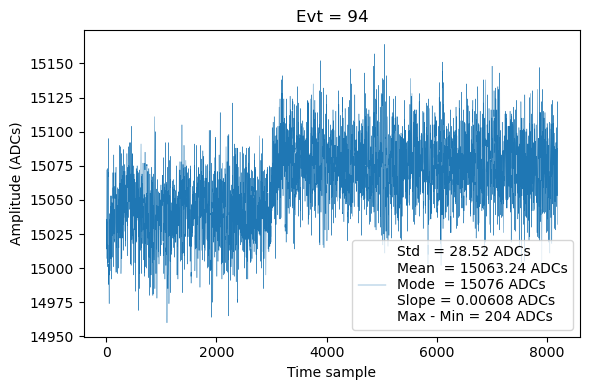

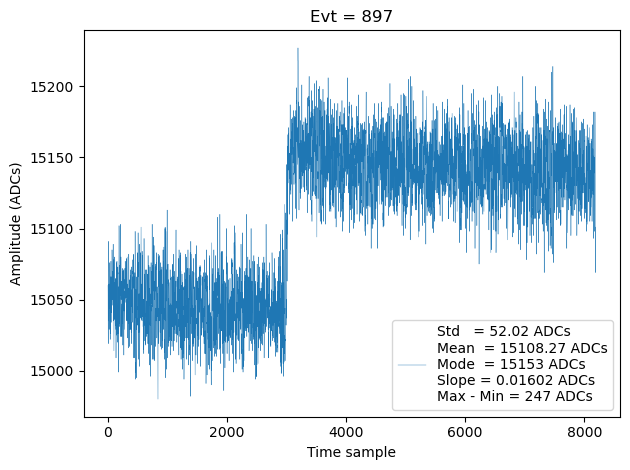

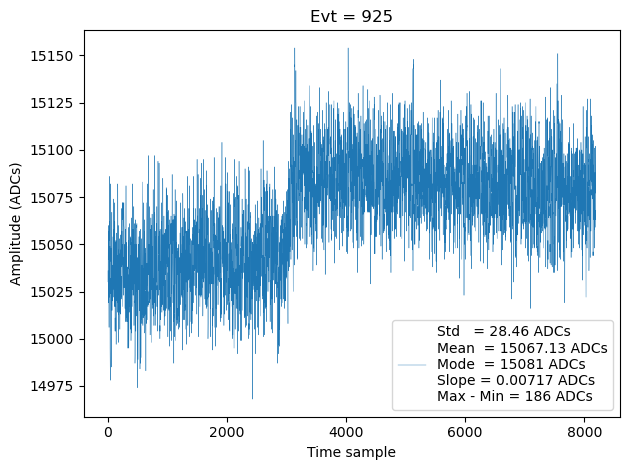

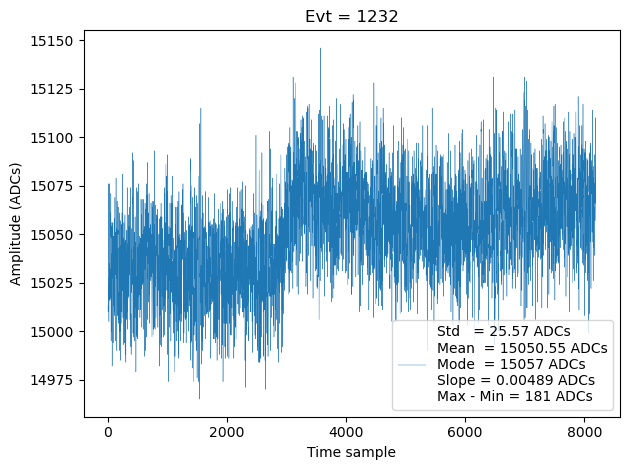

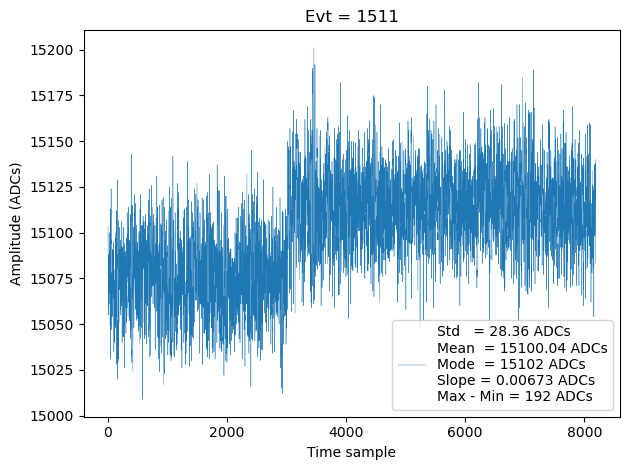

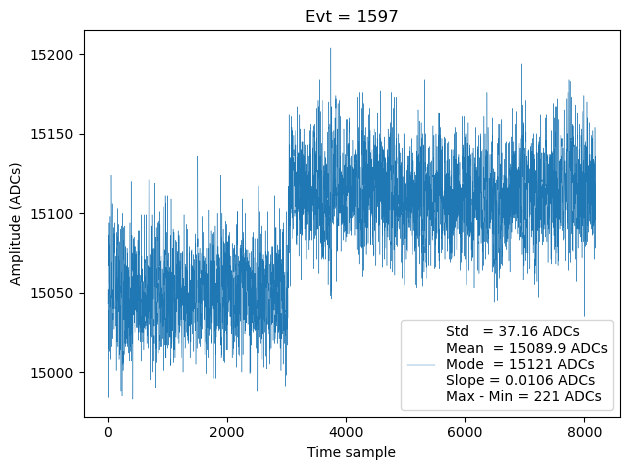

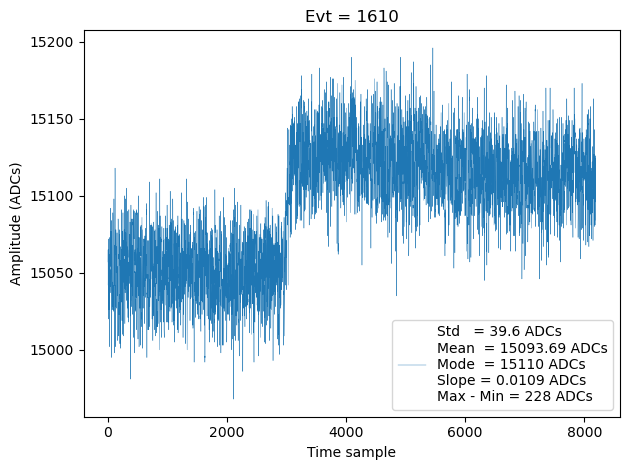

In [170]:
channel2 = 'ch1104001'
store2   = LH5Store() 
data_raw2, n_tot2 = store2.read_object(f'{channel2}/raw/waveform', wf_file, n_rows=np.inf)

plt.figure(figsize=(6, 4))
for i in range(len(data_raw2.values)):
    wf = data_raw2.values[i]
    if np.std(wf)>24.5 and np.std(wf)<100:
        slope = calculate_baseline_slope(wf)
        if slope > 0:
            max_min = np.max(wf) - np.min(wf)
            if max_min < 250:
                #if np.mean(wf)>14800:
                plt.plot(np.arange(len(wf)), wf, linewidth=0.3, label=string_stats(wf))
                plt.title(f'Evt = {i}')
                plt.xlabel('Time sample')
                plt.ylabel('Amplitude (ADCs)')
                plt.legend()
                plt.tight_layout()
                plt.show()

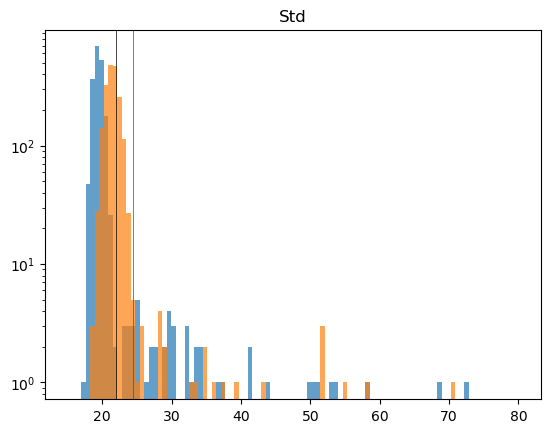

In [163]:
plt.hist([np.std(data_raw .values[i]) for i in range(len(data_raw .values))], bins=100, range=(15,80), log=True, alpha=0.7)
plt.hist([np.std(data_raw2.values[i]) for i in range(len(data_raw2.values))], bins=100, range=(15,80), log=True, alpha=0.7)
plt.axvline(x=22,   color='k', linewidth=0.5)
plt.axvline(x=24.5, color='r', linewidth=0.5)
plt.title('Std');

In [200]:
len(range(0, len(data_raw2.values), plots_per_row))

677

<Figure size 600x400 with 0 Axes>

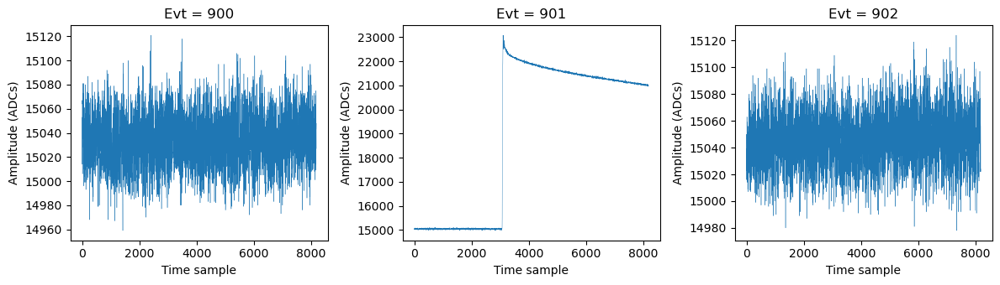

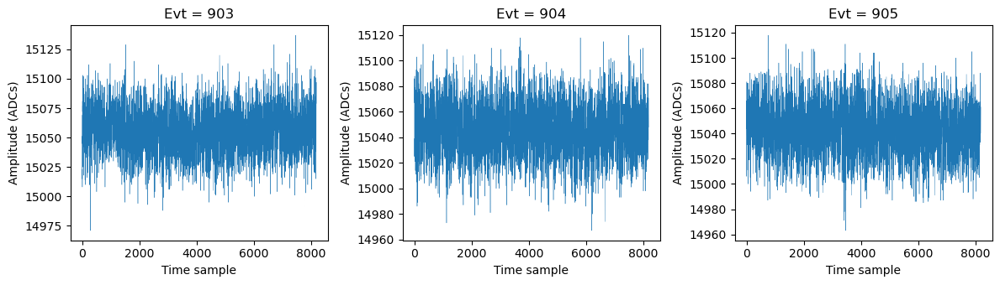

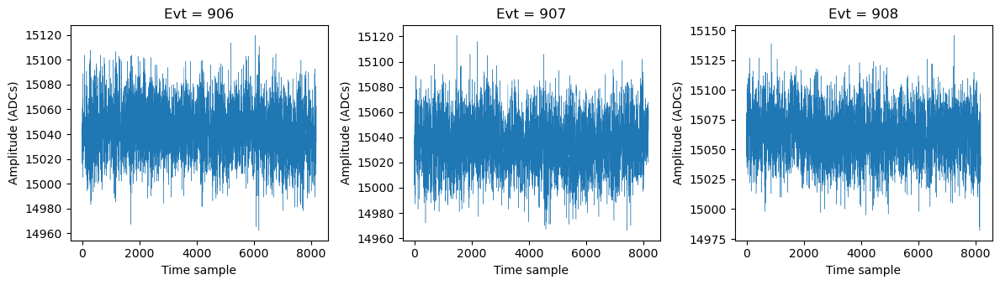

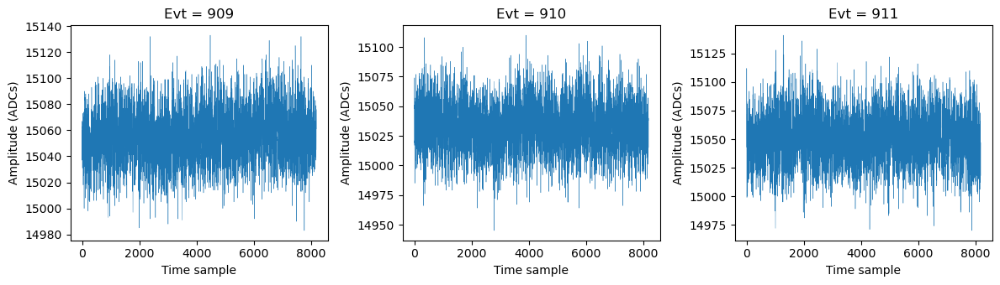

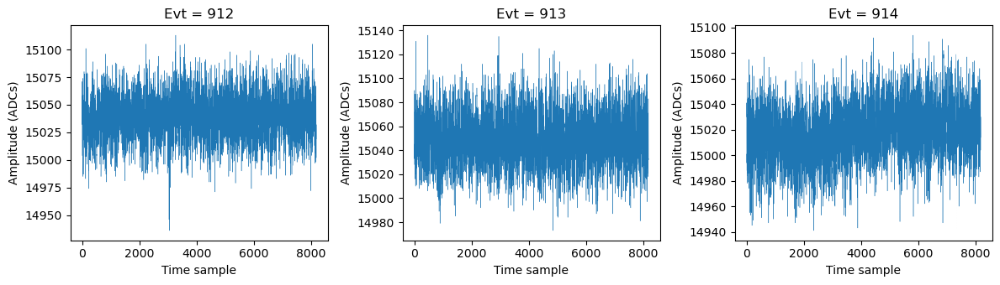

...

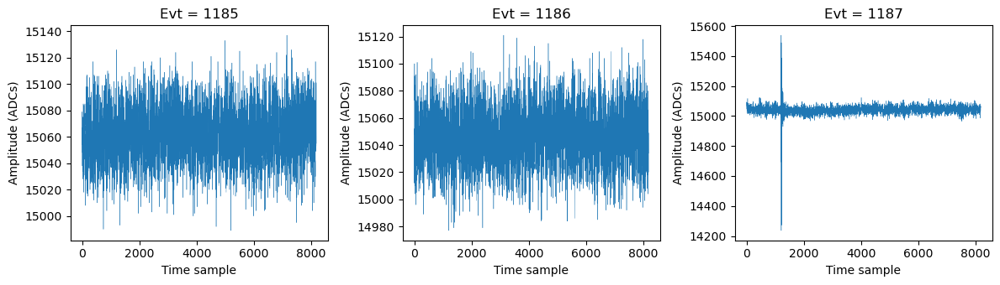

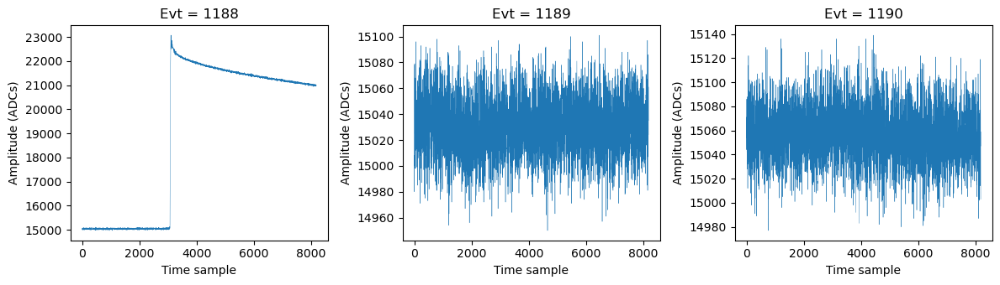

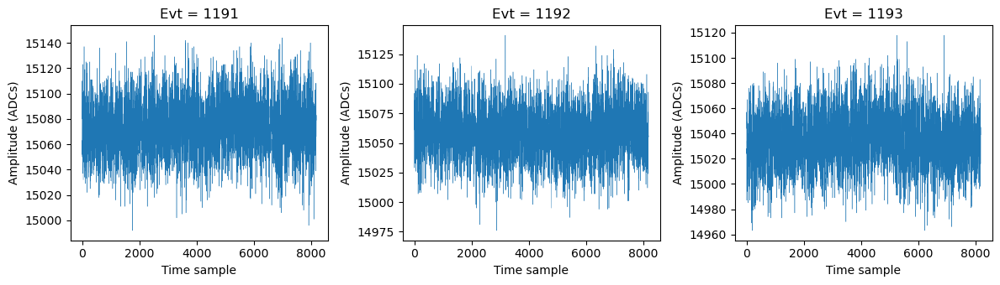

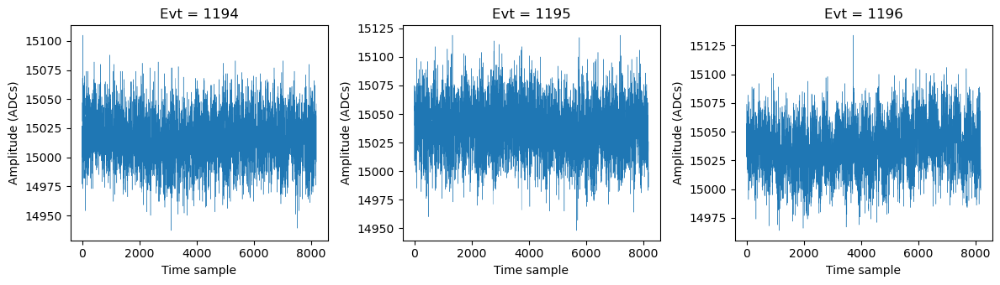

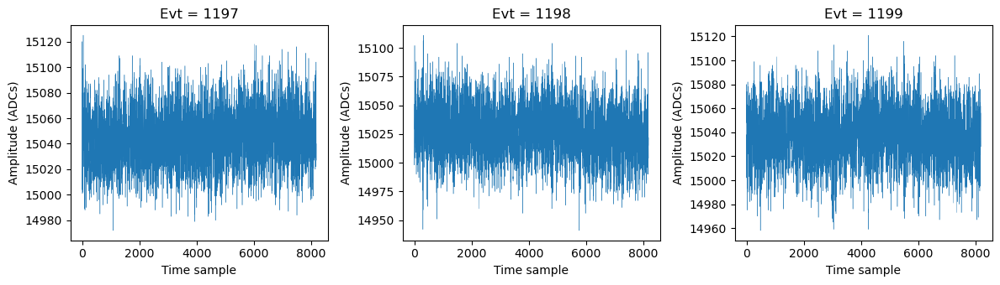

In [201]:
plots_per_row = 3
plt.figure(figsize=(6, 4))
for i in range(0, len(data_raw2.values), plots_per_row)[300:400]:
    fig, axs = plt.subplots(1, plots_per_row, figsize=(12, 3.5))
    for j, ax in enumerate(axs):
        ax.plot(np.arange(len(data_raw2.values[i+j])), data_raw2.values[i+j], linewidth=0.3)
        ax.set_title(f'Evt = {i+j}')
        ax.set_xlabel('Time sample')
        ax.set_ylabel('Amplitude (ADCs)')
    plt.tight_layout()
    plt.show()

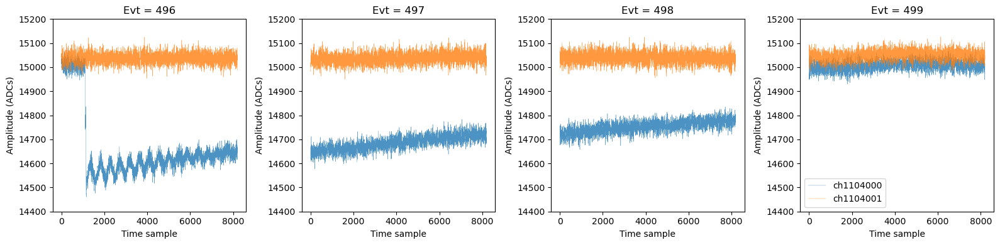

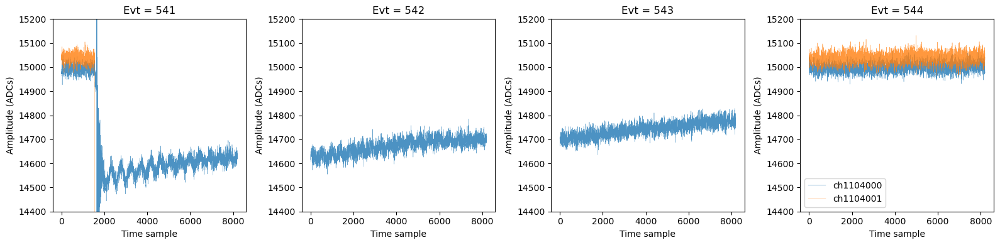

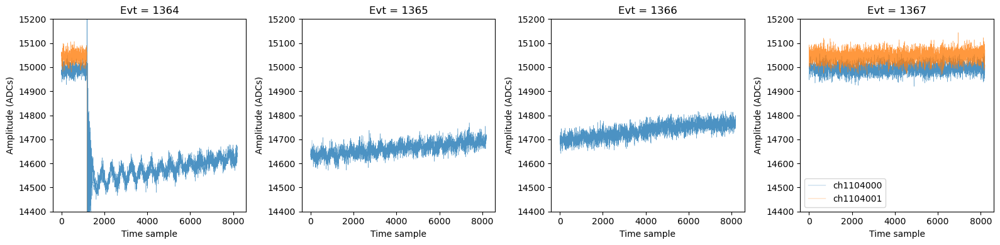

In [193]:
for evt in [497, 542, 1365]:
    fig, axs = plt.subplots(1, 4, figsize=(16, 4))
    for ax, add_val in zip(axs, [-1, 0, 1, 2]):
        ax.plot(np.arange(len(data_raw .values[evt+add_val])), data_raw .values[evt+add_val], linewidth=0.3, label='ch1104000', alpha=0.8)
        ax.plot(np.arange(len(data_raw2.values[evt+add_val])), data_raw2.values[evt+add_val], linewidth=0.3, label='ch1104001', alpha=0.8)
        ax.set_ylim(14400, 15200)
        ax.set_title(f'Evt = {evt+add_val}')
        ax.set_xlabel('Time sample')
        ax.set_ylabel('Amplitude (ADCs)')
    plt.tight_layout()
    plt.legend()

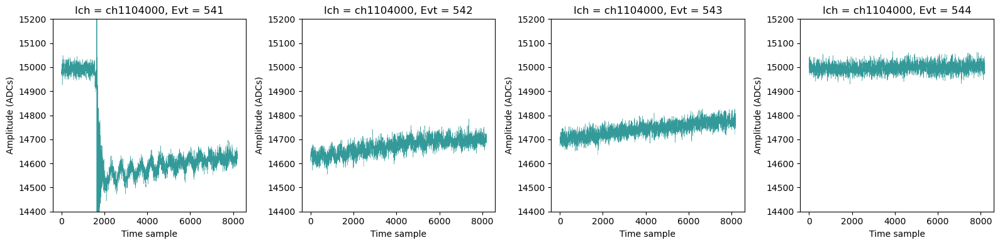

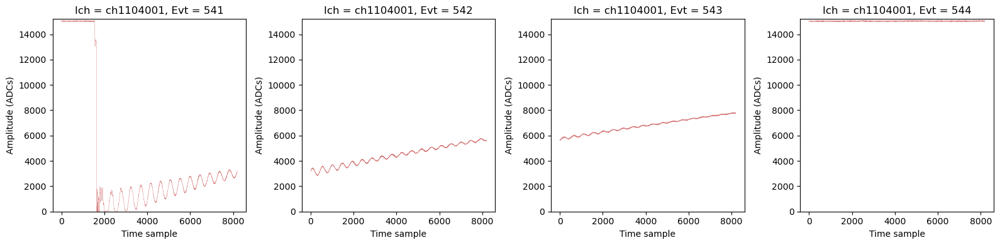

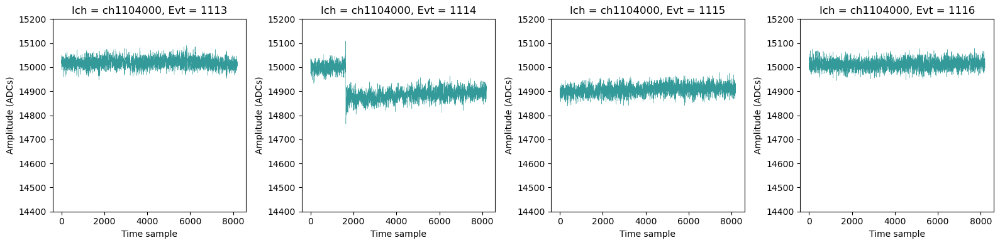

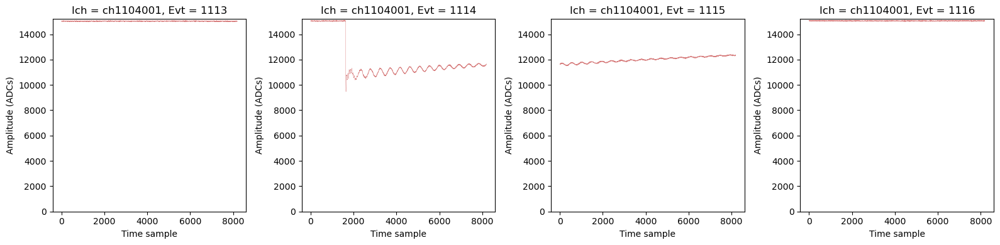

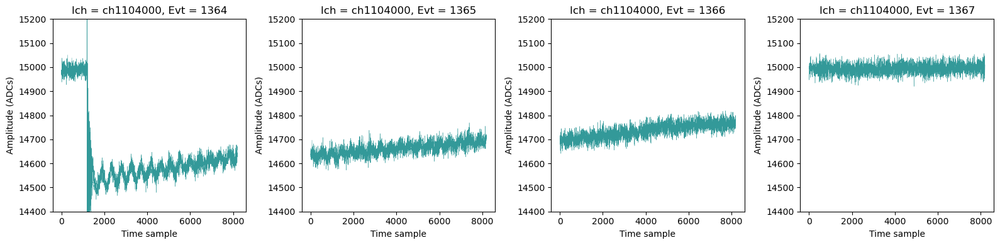

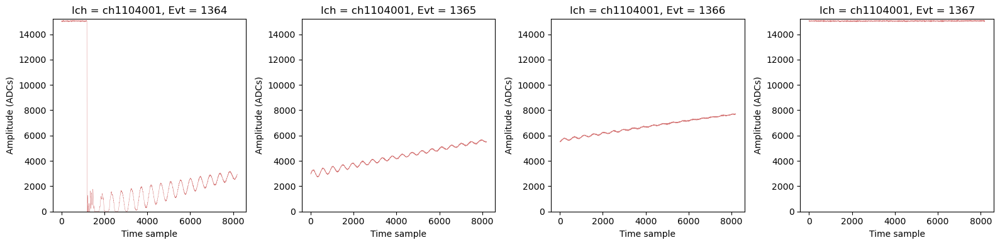

In [202]:
for evt in [542, 1114, 1365]:
    for data_r, ich, col, ymin in zip([data_raw, data_raw2], ['ch1104000', 'ch1104001'], ['teal', 'indianred'], [14400, 0]):
        fig, axs = plt.subplots(1, 4, figsize=(16, 4))
        for ax, add_val in zip(axs, [-1, 0, 1, 2]):
            ax.plot(np.arange(len(data_r.values[evt+add_val])), data_r.values[evt+add_val], linewidth=0.3, alpha=0.8, color=col)
            ax.set_ylim(ymin, 15200)
            ax.set_title(f'Ich = {ich}, Evt = {evt+add_val}')
            ax.set_xlabel('Time sample')
            ax.set_ylabel('Amplitude (ADCs)')
        plt.tight_layout()